#### 參考資料:
1. https://machinelearningmastery.com/how-to-develop-a-face-recognition-system-using-facenet-in-keras-and-an-svm-classifier/

## 連結google drive

## 解壓縮資料tar(如果資料損毀)

In [16]:
# !ls
# %cd '/content/drive/My Drive/FaceNet_Colab'
# !ls
# #!tar -xvf aia-tpe4-who-is-she.tar 
# print('\nunzip over')


### 1.開始計時

In [17]:
import time
start = time.time()
print("hello...%d"%start)


hello...1601075694


# 初始化模型建置:
首先，Import everythings to use.

### 1.安裝MTCNN模型

In [18]:
!pip install mtcnn

### 2.導入相關module
module指的是相關的程序檔案，可能是整份文件，也可能是其中的某幾個類別(class)。

In [19]:
# face detection for the 5 Celebrity Faces Dataset
from os import listdir
from os.path import isdir
from PIL import Image
from matplotlib import pyplot
from numpy import savez_compressed
from numpy import asarray
from mtcnn.mtcnn import MTCNN
# develop a classifier for the 5 Celebrity Faces Dataset
from random import choice
from numpy import load
from numpy import expand_dims
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.svm import SVC
import csv
import pandas as pd
from numpy import load
from numpy import expand_dims
from numpy import asarray
from keras.models import load_model

### 3.定義相關function:


#### extract_face
導入MTCNN()進行人臉識別。<br>
利用PIL module操作影像，並使用MTCNN模型進行辨識，並從中產出影像中包含的人臉影像，重新裁剪成一張160x160的影像。

In [20]:
# extract a single face from a given photograph

def extract_face(filename,  required_size=(160,  160)):
    # load image from file
    image  =  Image.open(filename)
    # convert to RGB, if needed
    image  =  image.convert('RGB')
    # convert to array
    pixels  =  asarray(image)
    # create the detector, using default weights
    detector  =  MTCNN()
    # detect faces in the image
    results  =  detector.detect_faces(pixels)
    # extract the bounding box from the first face
    x1,  y1,  width,  height  = results[0]['box']
    # bug fix
    x1,  y1  =  abs(x1),  abs(y1)
    x2,  y2  =  x1  +  width,  y1  +  height
    # extract the face
    face  =  pixels[y1:y2,  x1:x2]
    # resize pixels to the model size
    image  =  Image.fromarray(face)
    image  =  image.resize(required_size)
    face_array  =  asarray(image)
    return  face_array


#### load_faces10
應用extract_face從指定資料夾中，產出所有影像中包含的人臉影像。並產出所有檔案的列表，以及無法被處理人臉識別的影像列表。


In [21]:
# load images and extract faces for all images in a directory

def load_faces10(directory):
    except_file = list()
    files = list()
    faces  =  list()
    # enumerate files
    for  filename in  listdir(directory):
        # path
        print(filename)
        if filename == '.ipynb_checkpoints':
            continue
        if filename == '.csv':
            continue
        path  =  directory  +  filename
        print(path)
        filename = filename[:-4]
        # get face
        try:
            face  =  extract_face(path)
            # store
            faces.append(face)
            files.append(filename)
        except(IndexError,IsADirectoryError,OSError):
            except_file.append(filename)
            print('except file...'+str(filename))
            pass

    return  faces, files, except_file

#### load_dataset10
從指定資料夾中條列其子資料夾，並對每一個資料夾應用load_face10。最後會取得資料夾內所有類別的影像中包含的人臉影像，也會產出所有檔案的列表，以及無法被處理人臉嵌入的影像列表。

In [22]:
# load a dataset that contains one subdir for each class that in turn contains images

def load_dataset10(directory):
    X,  y  =  list(),  list()
    # enumerate folders, on per class
    list_file = []
    list_except_file = []
    for  subdir in  listdir(directory):
        # path
        if subdir == '.ipynb_checkpoints':
            continue

        path  =  directory  +  subdir  +  '/'
        # skip any files that might be in the dir
        if  not  isdir(path):
            continue
        # load all faces in the subdirectory
        faces, files, list_except_file =  load_faces10(path) # 改成修訂版
        list_file.append(files)
        # create labels
        labels  =  [subdir for  _  in  range(len(faces))]
        # summarize progress
        print('>loaded %d examples for class: %s'  %  (len(faces),  subdir))
        # store
        X.extend(faces)
        y.extend(labels)
        
    return  asarray(X),  asarray(y), list_file, list_except_file

#### load_dataset
從指定資料夾中條列其子資料夾，並對每一個資料夾應用load_face10。最後會取得資料夾內所有類別影像的人臉影像。

In [23]:
# load a dataset that contains one subdir for each class that in turn contains images
def load_dataset(directory, num):
    X,  y  =  list(),  list()
    # enumerate folders, on per class
    for  subdir in  listdir(directory):
        #print(subdir)
        # path
        if subdir == '.ipynb_checkpoints':
            continue
        path  =  directory  +  subdir  +  '/'
        # skip any files that might be in the dir
        if  not  isdir(path):
            continue
        # load all faces in the subdirectory
        faces  =  load_faces(path, num)
        # create labels
        labels  =  [subdir for  _  in  range(len(faces))]
        # summarize progress
        print('>loaded %d examples for class: %s'  %  (len(faces),  subdir))
        # store
        X.extend(faces)
        y.extend(labels)
    return  asarray(X),  asarray(y)

#### load_faces
應用extract_face從指定資料夾中，產出所有影像中包含的人臉影像。


In [24]:
# load images and extract faces for all images in a directory
def load_faces(directory, num):
    faces  =  list()
    # enumerate files
    
    for  filename in  listdir(directory):
        # path
        if filename == '.ipynb_checkpoints':
            continue
        path  =  directory  +  filename
        
        # get face
        try:
            if num is None:
                continue
            else:
                num = num-1
                if num<0:
                    break
            print(path)
            face  =  extract_face(path)
            # store
            faces.append(face)
        except(IndexError,IsADirectoryError,OSError):
            print('^^^-this file is error')
            num=num+1
            pass
    return  faces

#### list_dul
將list重新排列成 nxrow/ 1xcolumn 的list。

In [25]:
# Get all the strings in another list. Also reorganization it to a n*row/1*column array. 

def list_dul(lista):
    listb = []
    for i in range(len(lista)): # how many folders(classes) in original folder.
        for j in range(len(lista[i])): # how many images in each folder(class).
            a = lista[i][j]
            listb.append(a)
    return listb

#### get_embedding
從單一人臉影像中取得人臉嵌入(Face Embedding)

In [26]:
# get the face embedding for one face
def get_embedding(model,  face_pixels):
    # scale pixel values
    face_pixels  =  face_pixels.astype('float32')
    # standardize pixel values across channels (global)
    mean,  std  =  face_pixels.mean(),  face_pixels.std()
    face_pixels  =  (face_pixels  -  mean)  /  std
    # transform face into one sample
    samples  =  expand_dims(face_pixels,  axis=0)
    # make prediction to get embedding
    yhat  =  model.predict(samples)
    #print(yhat[0])
    return  yhat[0]

# 輸入影像並產生人臉嵌入(Face Embedding)
---

### 1.設定資料夾路徑

In [27]:
print('training_set')



# !ls '/content/drive/My Drive/FaceNet_Colab/aia-tpe4-who-is-she/training_set/'
dir_training_data = './training_set/'

print('testing_set')
# !ls '/content/drive/My Drive/FaceNet_Colab/aia-tpe4-who-is-she/valid/'
#testing_data = '/content/drive/My Drive/FaceNet_Colab/aia-tpe4-who-is-she/testing_set/' #testing data
dir_testing_data = './testing_set/' 


training_set
testing_set


### 2.設定變數名稱
其中包含兩個在過程中會產出的資料壓縮檔，分別是:
1. 來源資料的資料壓縮檔
2. 人臉嵌入壓縮檔(包括訓練與測試資料)

In [28]:
# Setting name 
new_dataset = 'girls_dataset30.npz'
new_embeddings= 'girls_embeddings30.npz'
# 20 for dul
# 30 for ori


### 3.應用 load_dataset 從指定資料夾中導入訓練資料
可以指定訓練資料個數

In [29]:
# load train dataset 

print('start to load and extract face image in training set')
#trainX,  trainy  =  load_dataset('aia-tpe4-who-is-she/training_set')
trainX,  trainy  =  load_dataset(dir_training_data,3)
print(trainX.shape,  trainy.shape)

start to load and extract face image in training set
./training_set/akane/004.png
./training_set/akane/022.png
./training_set/akane/014.png
>loaded 3 examples for class: akane
./training_set/risa/004.png
./training_set/risa/022.png
./training_set/risa/014.png
>loaded 3 examples for class: risa
./training_set/neru/004.png
./training_set/neru/022.png
./training_set/neru/014.png
^^^-this file is error
./training_set/neru/034.png
>loaded 3 examples for class: neru
./training_set/rika/004.png
./training_set/rika/022.png
./training_set/rika/014.png
>loaded 3 examples for class: rika
./training_set/yui/004.png
./training_set/yui/022.png
./training_set/yui/014.png
>loaded 3 examples for class: yui
(15, 160, 160, 3) (15,)


### 4.應用 load_dataset10 從指定資料夾導入測試(驗證)資料


In [30]:
# load test dataset 
print('start to load and extractface image in testing set')
testX,  testy, list_file, list_except_file =  load_dataset10(dir_testing_data)
list_file = list_dul(list_file)

start to load and extractface image in testing set
7B0702E9FD.png
./testing_set/akane/7B0702E9FD.png
43A15DDE89.png
./testing_set/akane/43A15DDE89.png
E6A9AED5E7.png
./testing_set/akane/E6A9AED5E7.png
36063E5BF3.png
./testing_set/akane/36063E5BF3.png


KeyboardInterrupt: 

### 5.將訓練資料與測試資料壓縮成一個人臉資料封包
人臉資料封包(new_dataset)中所有影像都只有人臉部分。<br>此過程同時也將無法被處理人臉嵌入的檔案存成一個panda array，留在記憶體中備用。

In [16]:
# save except file as a panda array
list_except_file = pd.DataFrame(list_except_file)
print('有 %d 個無法處理人臉嵌入的影像'%len(list_except_file))

# print text data list
print('list_file len:' + str(len (list_file)))
print(testX.shape,  testy.shape)

# save arrays to one file in compressed format  
savez_compressed(new_dataset,  trainX,  trainy,  testX,  testy)

有 8 個無法處理人臉嵌入的影像
list_file len:430
(430, 160, 160, 3) (430,)


### 6.導入人臉資料封包以及FaceNet模型
facenet_keras.h5需要放在正確位置。可以透過 !ls 來確認所在位置是否包含該檔案。

In [17]:
#data  =  load('girls_dataset20.npz')
data  =  load(new_dataset)

trainX,  trainy,  testX,  testy  =  data['arr_0'],  data['arr_1'],  data['arr_2'],  data['arr_3']
print('Loaded: ',  trainX.shape,  trainy.shape,  testX.shape,  testy.shape)
print(type(trainX))
# load the facenet model
!ls 
model  =  load_model('facenet_keras.h5')
print('Loaded Model')

Loaded:  (150, 160, 160, 3) (150,) (430, 160, 160, 3) (430,)
<class 'numpy.ndarray'>
classmap.csv		girls_embeddings30.npz	testing_set.tar
facenet_keras.h5	result.csv		training_set
FaceNet_organize.ipynb	sample_submission.csv	training_set.tar
girls_dataset30.npz	testing_set
Loaded Model


/opt/conda/lib/python3.7/site-packages/keras/engine/saving.py:341: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


### 7.應用get_embedding取得所有資料的人臉嵌入(Face Embedding)
最後會壓縮成一個包含所有人臉嵌入資料的檔案new_embeddings。

In [18]:
# convert each face in the train set to an embedding
newTrainX  =  list()
for  face_pixels in  trainX:
    embedding  =  get_embedding(model,  face_pixels)
    newTrainX.append(embedding)
newTrainX  =  asarray(newTrainX)
print(newTrainX.shape)
# convert each face in the test set to an embedding
newTestX  =  list()
for  face_pixels in  testX:
    embedding  =  get_embedding(model,  face_pixels)
    newTestX.append(embedding)
newTestX  =  asarray(newTestX)
print(newTestX.shape)
# save arrays to one file in compressed format 

#savez_compressed('girls_embeddings20.npz',  newTrainX,  trainy,  newTestX,  testy)
savez_compressed(new_embeddings,  newTrainX,  trainy,  newTestX,  testy)


(150, 128)
(430, 128)


# 進行模型訓練

## 1.使用keras內建的SVC模型進行訓練
投入FaceNet產生的人臉嵌入進行訓練。此過程中使用LabelEncoder來將字串形式的類別以數值編排。

In [19]:
# develop a classifier for Dataset
from random import choice
from numpy import load
from numpy import expand_dims
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.svm import SVC 
from matplotlib import pyplot
import csv
# load faces
#data  =  load('girls_dataset10.npz')
# Load new faces J:

#data  =  load('girls_dataset10.npz')
data  =  load(new_dataset)

testX_faces  =  data['arr_2']
print('待測試資料整體的型態:')
print(data['arr_2'].shape)
print('待測試資料個體的型態:')
print(data['arr_2'][0].shape)

# load face embeddings
#data  =  load('girls_embeddings10.npz')
data  =  load(new_embeddings)

trainX,  trainy,  testX,  testy  =  data['arr_0'],  data['arr_1'],  data['arr_2'],  data['arr_3']
# normalize input vectors
in_encoder  =  Normalizer(norm='l2')
trainX  =  in_encoder.transform(trainX)
testX  =  in_encoder.transform(testX)
# label encode targets
out_encoder  =  LabelEncoder()
out_encoder.fit(trainy)
trainy  =  out_encoder.transform(trainy)
testy  =  out_encoder.transform(testy)
# fit model
model  =  SVC(kernel='linear',  probability=True)
model.fit(trainX,  trainy)

待測試資料整體的型態:
(430, 160, 160, 3)
待測試資料個體的型態:
(160, 160, 3)


SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
    kernel='linear', max_iter=-1, probability=True, random_state=None,
    shrinking=True, tol=0.001, verbose=False)

## 2.完成訓練

## 3.停止計時

In [20]:
endTraining = time.time()
print(endTraining - start)

596.3433067798615


# 進行預測

## 1.對所有資料進行預測，產出預測列表並打印出圖片

Predicted: yui (89.733)
Expected: akane


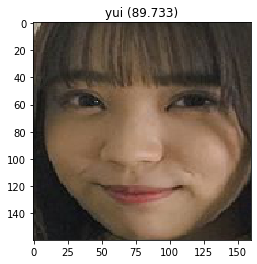

Predicted: akane (33.787)
Expected: akane


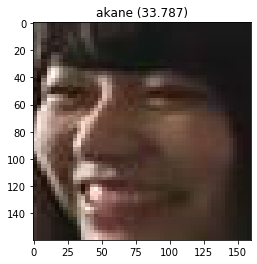

Predicted: akane (78.407)
Expected: akane


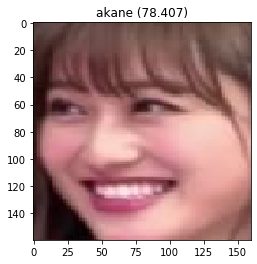

Predicted: akane (35.167)
Expected: akane


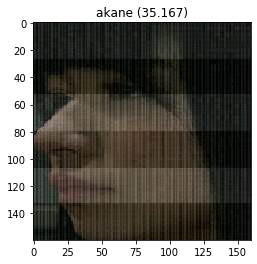

Predicted: rika (41.057)
Expected: akane


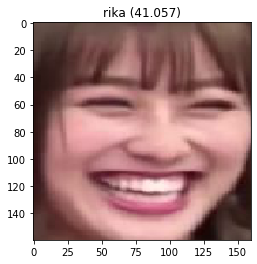

Predicted: neru (30.095)
Expected: akane


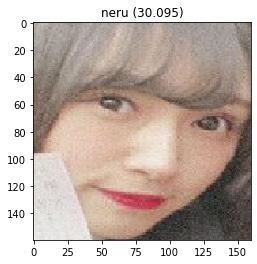

Predicted: neru (87.225)
Expected: akane


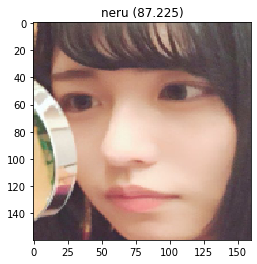

Predicted: risa (69.614)
Expected: akane


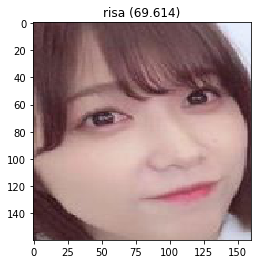

Predicted: yui (87.640)
Expected: akane


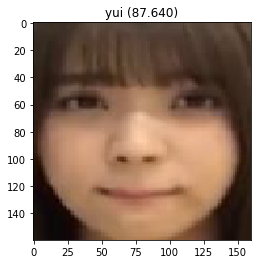

Predicted: rika (41.959)
Expected: akane


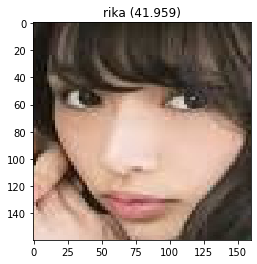

Predicted: risa (72.224)
Expected: akane


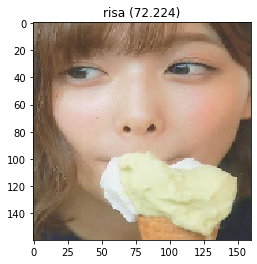

Predicted: rika (84.111)
Expected: akane


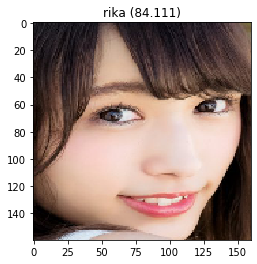

Predicted: akane (88.482)
Expected: akane


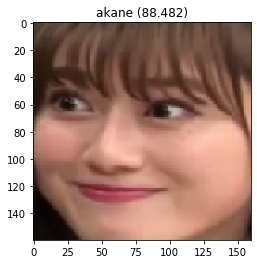

Predicted: risa (95.153)
Expected: akane


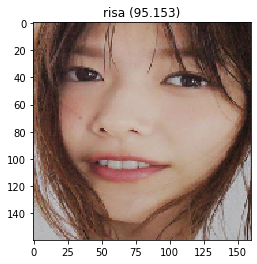

Predicted: neru (83.338)
Expected: akane


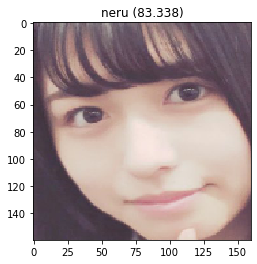

Predicted: rika (67.169)
Expected: akane


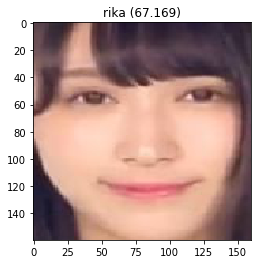

Predicted: risa (95.420)
Expected: akane


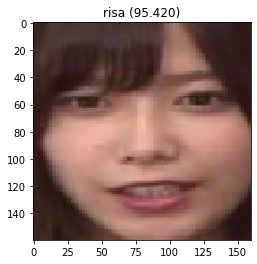

Predicted: rika (88.098)
Expected: akane


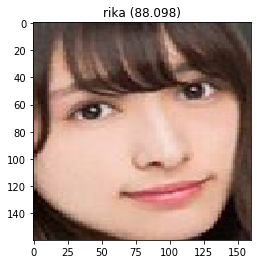

Predicted: akane (83.280)
Expected: akane


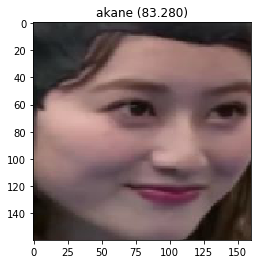

Predicted: neru (85.855)
Expected: akane


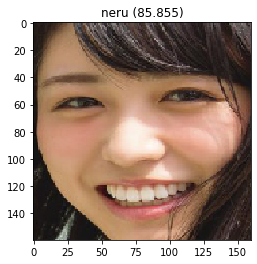

Predicted: akane (92.812)
Expected: akane


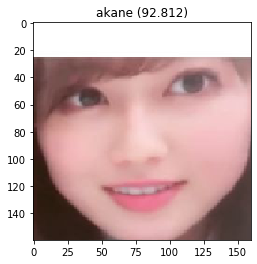

Predicted: akane (67.150)
Expected: akane


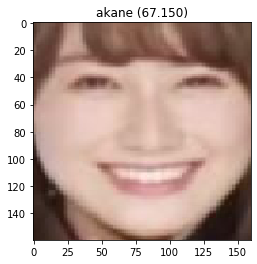

Predicted: akane (64.095)
Expected: akane


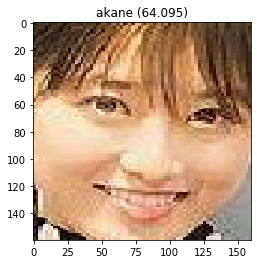

Predicted: yui (72.145)
Expected: akane


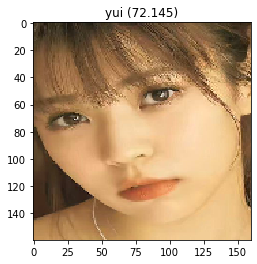

Predicted: yui (82.289)
Expected: akane


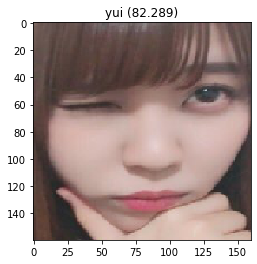

Predicted: yui (84.531)
Expected: akane


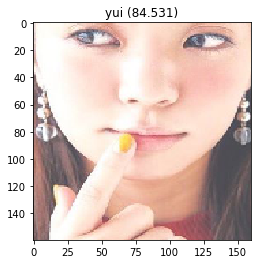

Predicted: risa (96.238)
Expected: akane


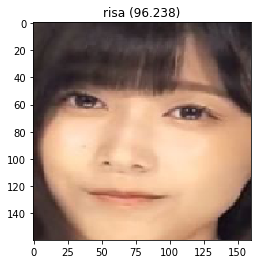

Predicted: akane (49.247)
Expected: akane


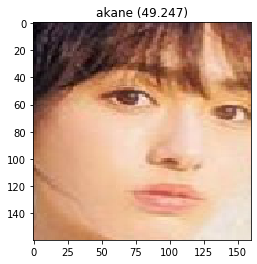

Predicted: neru (60.813)
Expected: akane


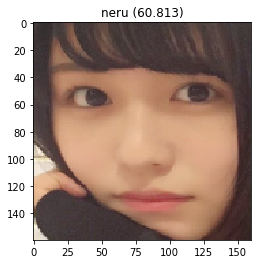

Predicted: akane (78.672)
Expected: akane


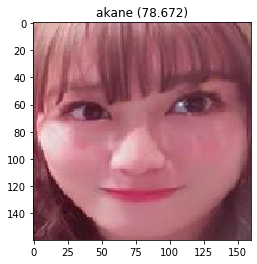

Predicted: neru (90.329)
Expected: akane


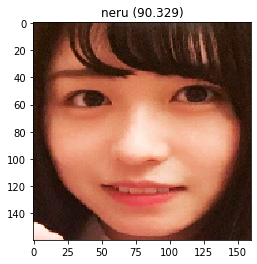

Predicted: akane (69.543)
Expected: akane


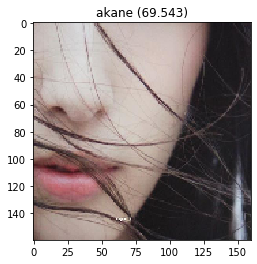

Predicted: neru (80.077)
Expected: akane


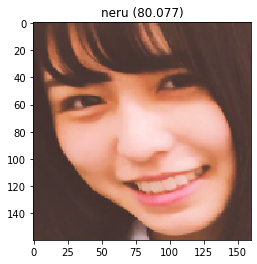

Predicted: neru (84.808)
Expected: akane


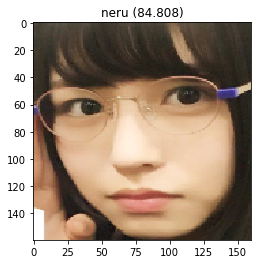

Predicted: risa (90.983)
Expected: akane


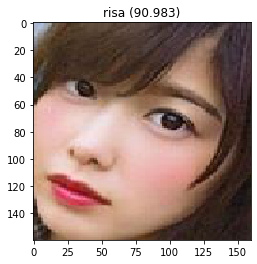

Predicted: rika (48.060)
Expected: akane


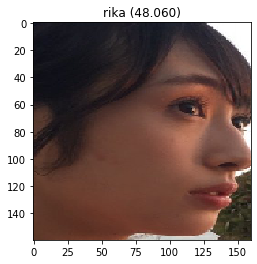

Predicted: neru (66.759)
Expected: akane


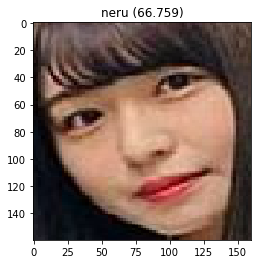

Predicted: akane (80.782)
Expected: akane


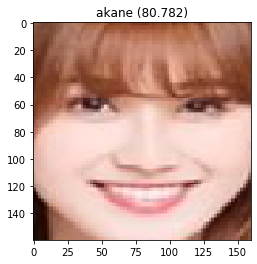

Predicted: akane (89.281)
Expected: akane


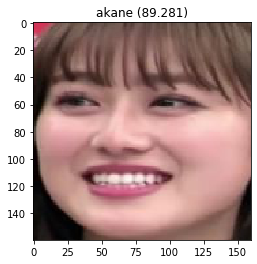

Predicted: neru (43.372)
Expected: akane


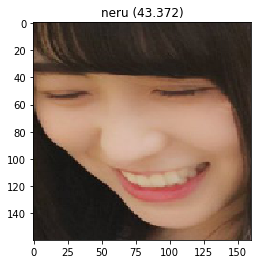

Predicted: neru (88.573)
Expected: akane


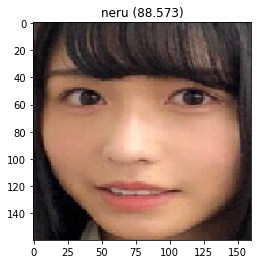

Predicted: neru (85.546)
Expected: akane


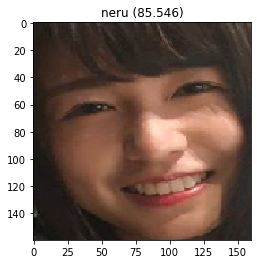

Predicted: akane (87.341)
Expected: akane


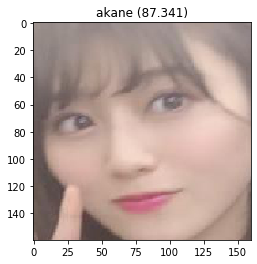

Predicted: risa (66.415)
Expected: akane


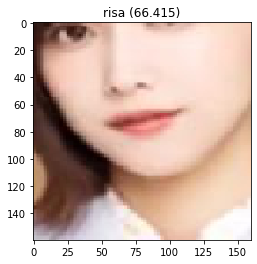

Predicted: yui (48.627)
Expected: akane


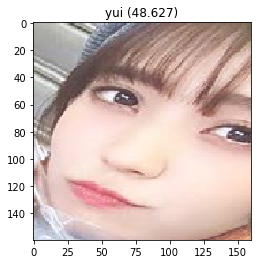

Predicted: rika (82.759)
Expected: akane


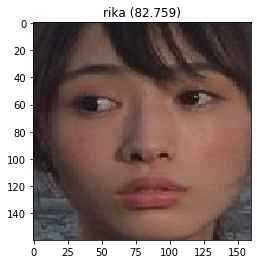

Predicted: risa (86.685)
Expected: akane


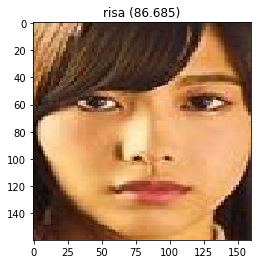

Predicted: neru (54.440)
Expected: akane


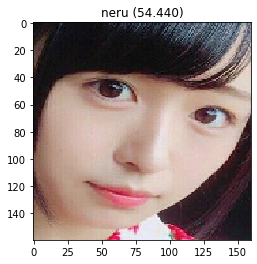

Predicted: neru (72.727)
Expected: akane


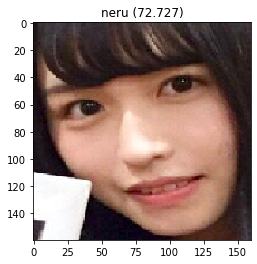

Predicted: akane (56.631)
Expected: akane


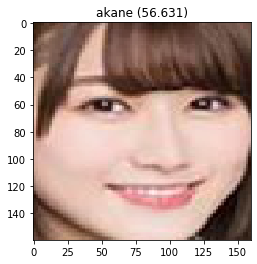

Predicted: akane (66.821)
Expected: akane


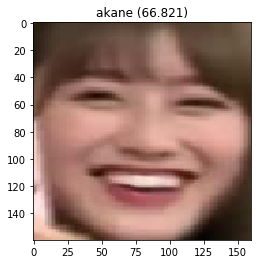

Predicted: rika (66.331)
Expected: akane


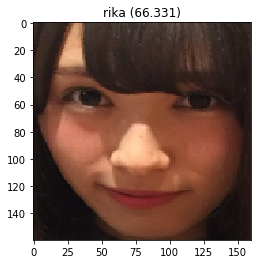

Predicted: neru (78.349)
Expected: akane


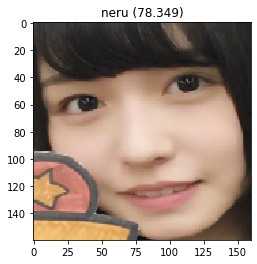

Predicted: neru (86.382)
Expected: akane


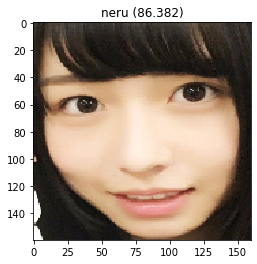

Predicted: yui (86.166)
Expected: akane


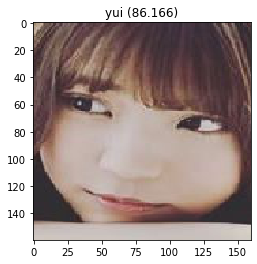

Predicted: yui (90.058)
Expected: akane


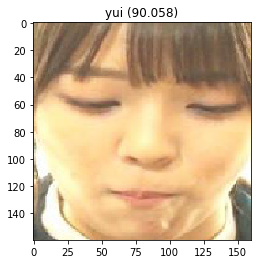

Predicted: yui (92.854)
Expected: akane


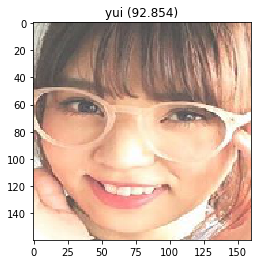

Predicted: akane (43.317)
Expected: akane


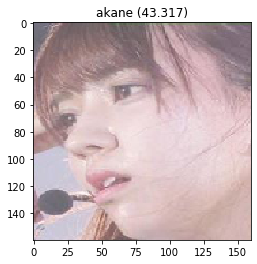

Predicted: yui (96.325)
Expected: akane


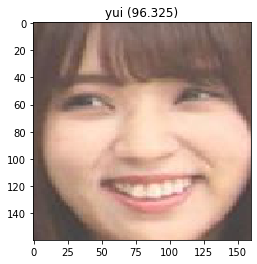

Predicted: neru (58.520)
Expected: akane


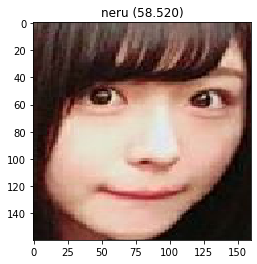

Predicted: yui (44.258)
Expected: akane


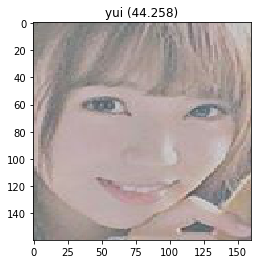

Predicted: neru (89.893)
Expected: akane


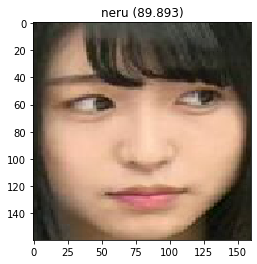

Predicted: neru (91.208)
Expected: akane


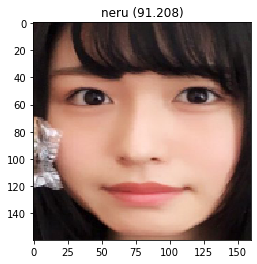

Predicted: akane (88.307)
Expected: akane


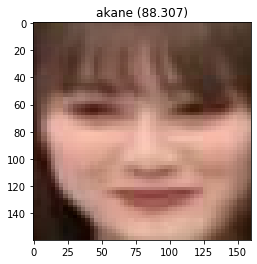

Predicted: yui (65.946)
Expected: akane


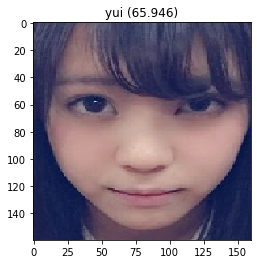

Predicted: risa (90.456)
Expected: akane


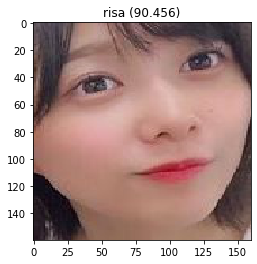

Predicted: risa (74.594)
Expected: akane


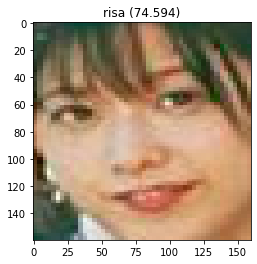

Predicted: yui (61.325)
Expected: akane


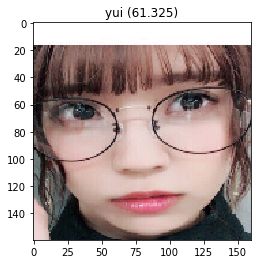

Predicted: neru (85.948)
Expected: akane


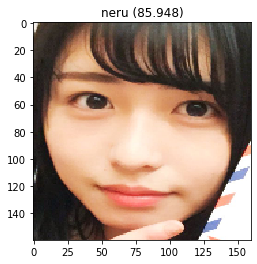

Predicted: rika (58.051)
Expected: akane


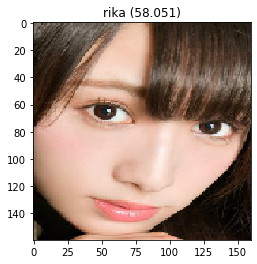

Predicted: neru (83.122)
Expected: akane


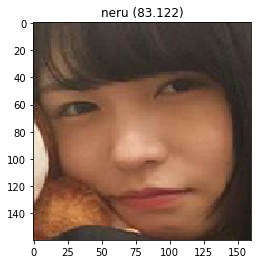

Predicted: rika (57.815)
Expected: akane


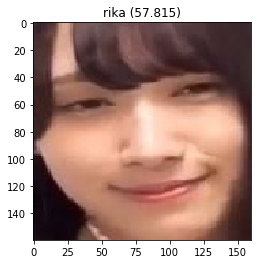

Predicted: yui (28.991)
Expected: akane


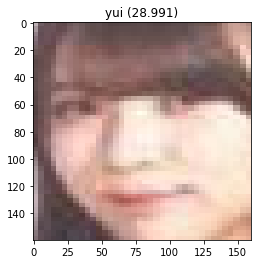

Predicted: risa (79.257)
Expected: akane


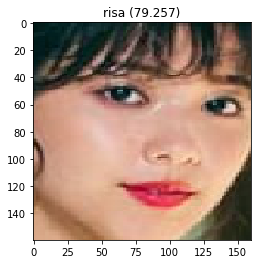

Predicted: neru (71.166)
Expected: akane


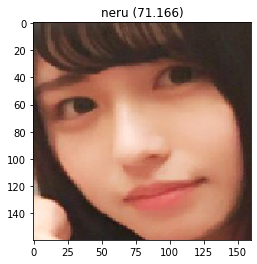

Predicted: akane (86.671)
Expected: akane


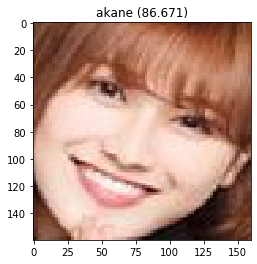

Predicted: rika (49.299)
Expected: akane


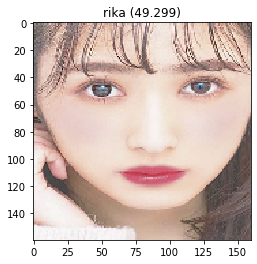

Predicted: rika (63.712)
Expected: akane


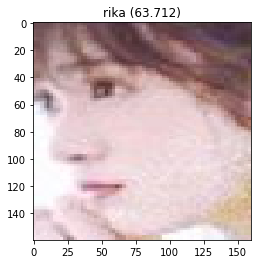

Predicted: neru (78.236)
Expected: akane


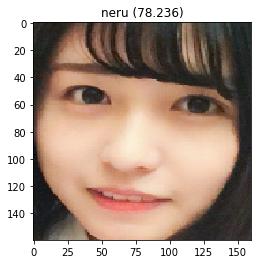

Predicted: yui (43.695)
Expected: akane


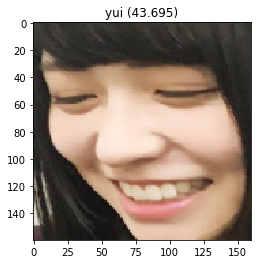

Predicted: rika (44.700)
Expected: akane


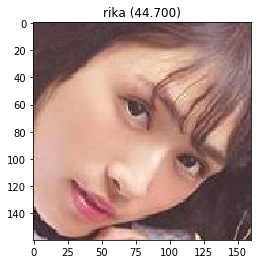

Predicted: neru (91.503)
Expected: akane


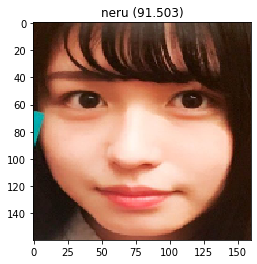

Predicted: yui (79.739)
Expected: akane


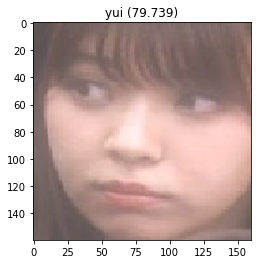

Predicted: neru (74.441)
Expected: akane


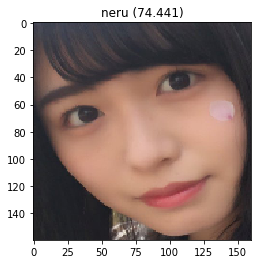

Predicted: risa (83.013)
Expected: akane


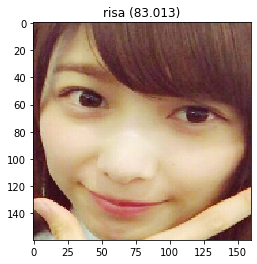

Predicted: akane (71.605)
Expected: akane


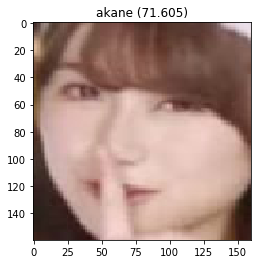

Predicted: neru (70.756)
Expected: akane


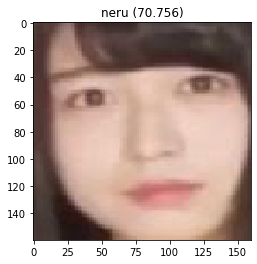

Predicted: rika (52.842)
Expected: akane


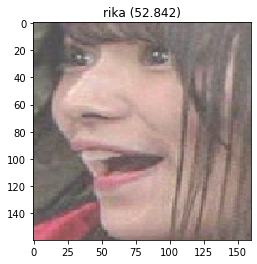

Predicted: akane (39.950)
Expected: akane


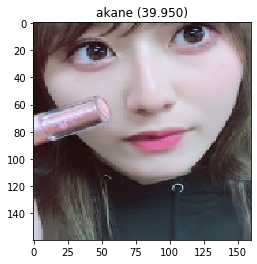

Predicted: yui (92.517)
Expected: akane


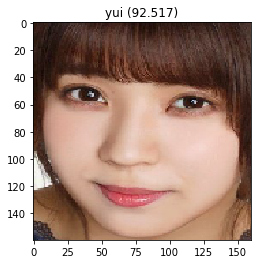

Predicted: risa (87.296)
Expected: akane


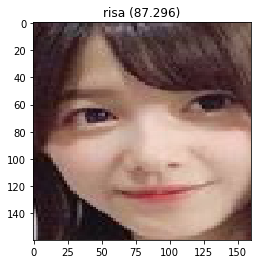

Predicted: yui (95.659)
Expected: akane


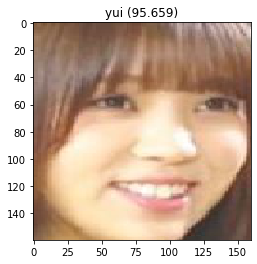

Predicted: rika (43.287)
Expected: akane


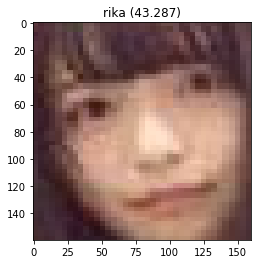

Predicted: rika (82.193)
Expected: akane


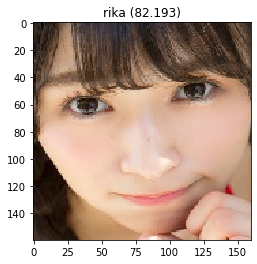

Predicted: yui (76.083)
Expected: akane


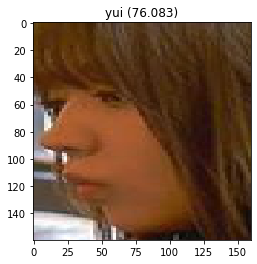

Predicted: akane (84.037)
Expected: akane


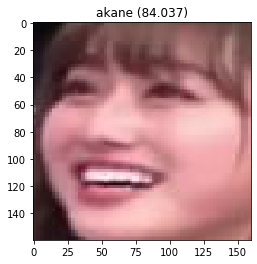

Predicted: akane (81.801)
Expected: akane


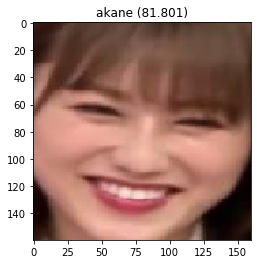

Predicted: risa (79.618)
Expected: akane


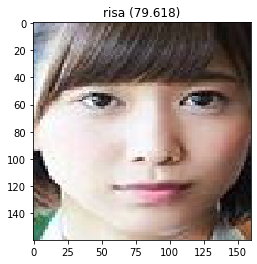

Predicted: rika (55.413)
Expected: akane


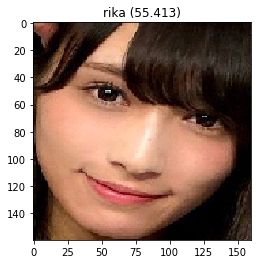

Predicted: risa (96.174)
Expected: akane


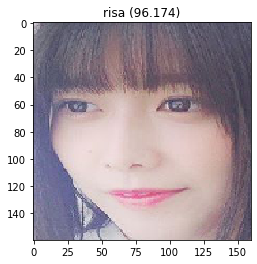

Predicted: neru (78.577)
Expected: akane


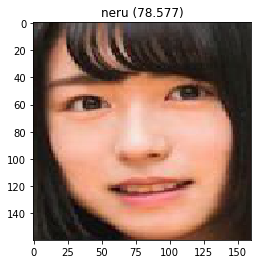

Predicted: neru (57.253)
Expected: akane


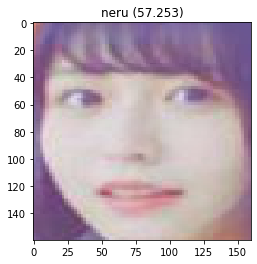

Predicted: neru (83.630)
Expected: akane


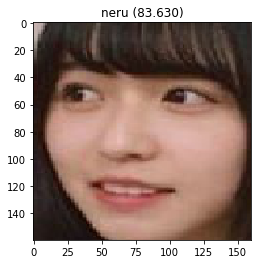

Predicted: rika (51.665)
Expected: akane


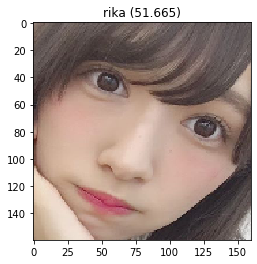

Predicted: risa (79.187)
Expected: akane


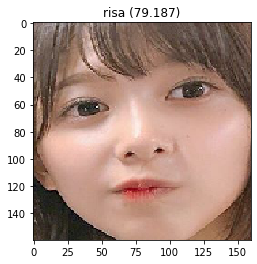

Predicted: rika (37.805)
Expected: akane


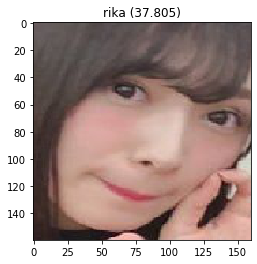

Predicted: risa (91.990)
Expected: akane


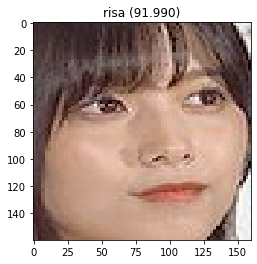

Predicted: neru (84.500)
Expected: akane


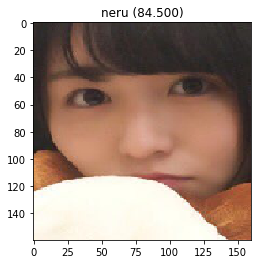

Predicted: risa (78.370)
Expected: akane


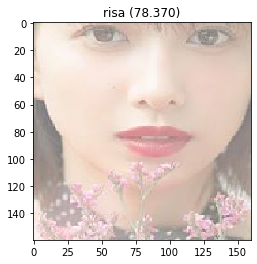

Predicted: akane (71.661)
Expected: akane


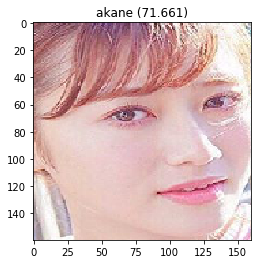

Predicted: akane (91.536)
Expected: akane


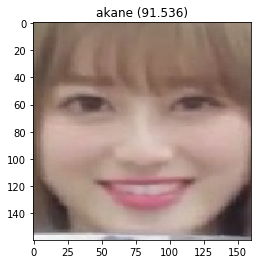

Predicted: neru (47.231)
Expected: akane


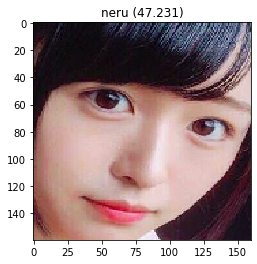

Predicted: rika (79.874)
Expected: akane


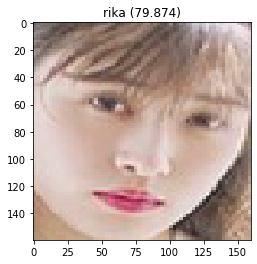

Predicted: rika (63.564)
Expected: akane


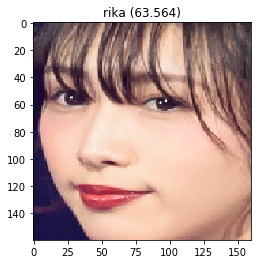

Predicted: neru (43.510)
Expected: akane


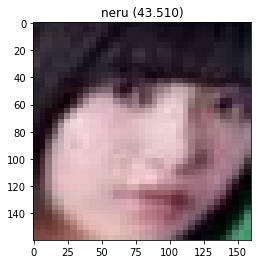

Predicted: neru (83.203)
Expected: akane


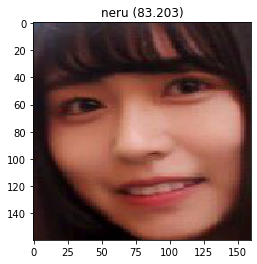

Predicted: rika (39.854)
Expected: akane


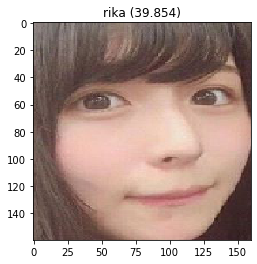

Predicted: akane (79.922)
Expected: akane


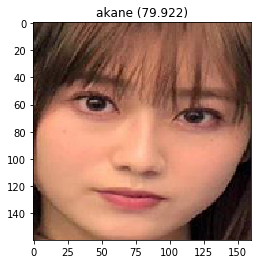

Predicted: neru (82.029)
Expected: akane


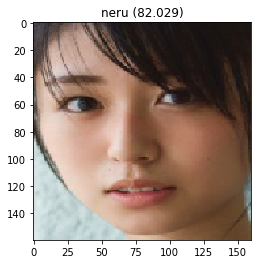

Predicted: risa (97.373)
Expected: akane


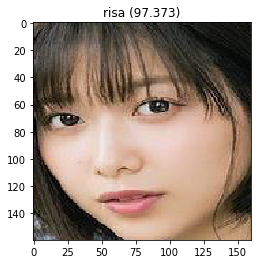

Predicted: risa (92.802)
Expected: akane


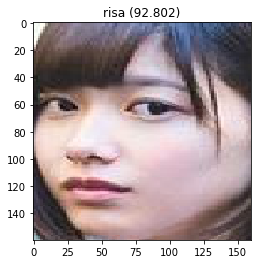

Predicted: neru (90.916)
Expected: akane


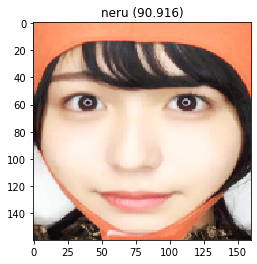

Predicted: yui (92.896)
Expected: akane


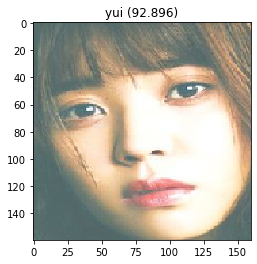

Predicted: neru (83.330)
Expected: akane


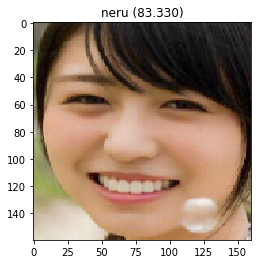

Predicted: neru (74.063)
Expected: akane


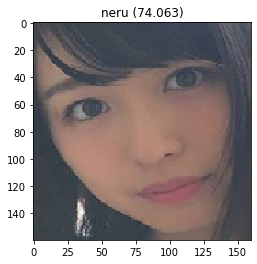

Predicted: risa (34.765)
Expected: akane


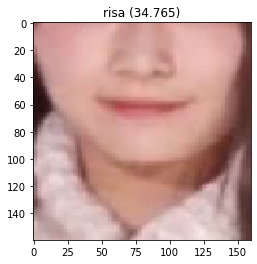

Predicted: neru (36.629)
Expected: akane


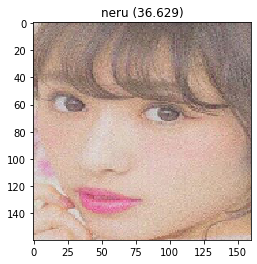

Predicted: akane (70.923)
Expected: akane


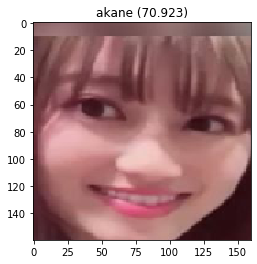

Predicted: rika (83.556)
Expected: akane


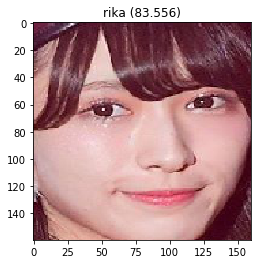

Predicted: akane (45.589)
Expected: akane


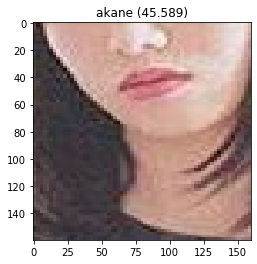

Predicted: rika (30.136)
Expected: akane


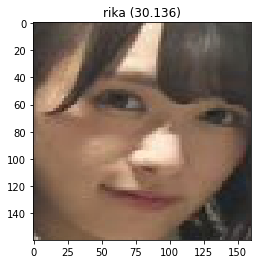

Predicted: akane (88.682)
Expected: akane


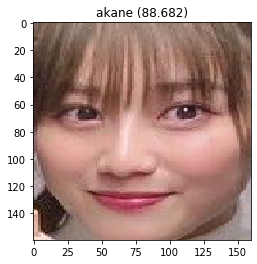

Predicted: yui (46.521)
Expected: akane


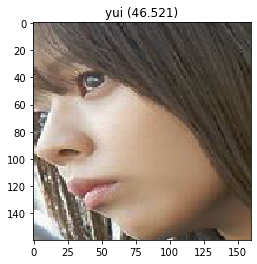

Predicted: rika (32.397)
Expected: akane


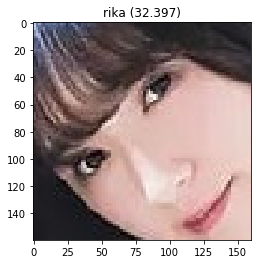

Predicted: akane (51.924)
Expected: akane


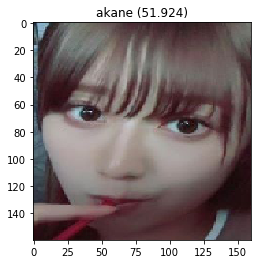

Predicted: yui (37.411)
Expected: akane


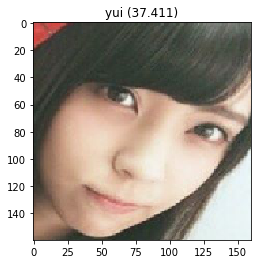

Predicted: risa (89.098)
Expected: akane


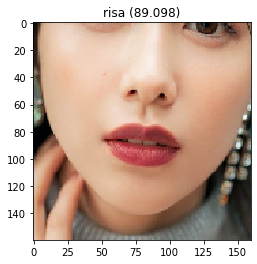

Predicted: akane (91.560)
Expected: akane


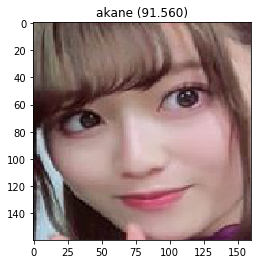

Predicted: rika (64.753)
Expected: akane


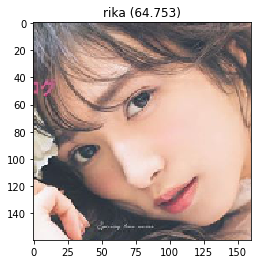

Predicted: akane (59.578)
Expected: akane


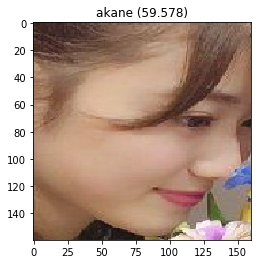

Predicted: rika (35.932)
Expected: akane


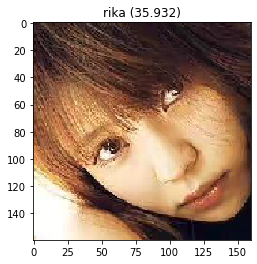

Predicted: neru (92.013)
Expected: akane


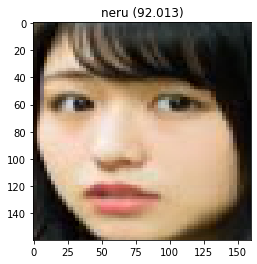

Predicted: neru (84.584)
Expected: akane


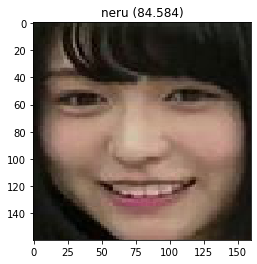

Predicted: neru (83.736)
Expected: akane


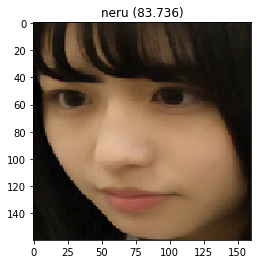

Predicted: risa (71.957)
Expected: akane


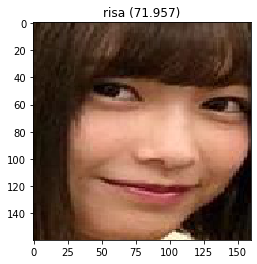

Predicted: risa (93.737)
Expected: akane


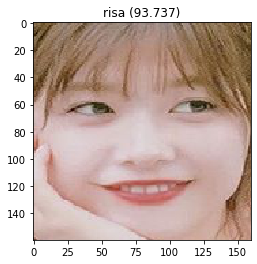

Predicted: risa (82.885)
Expected: akane


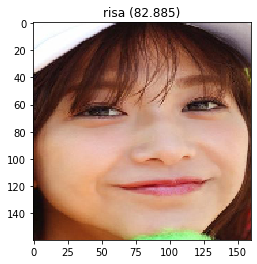

Predicted: akane (78.535)
Expected: akane


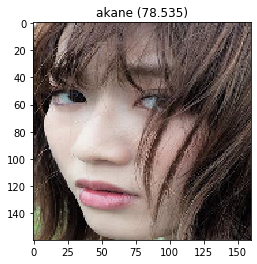

Predicted: akane (93.427)
Expected: akane


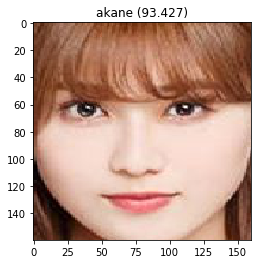

Predicted: yui (75.197)
Expected: akane


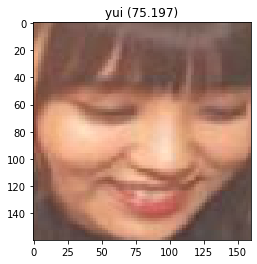

Predicted: neru (80.722)
Expected: akane


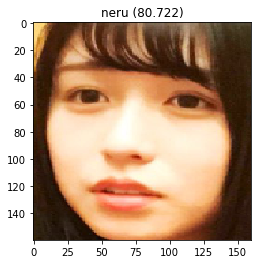

Predicted: akane (66.412)
Expected: akane


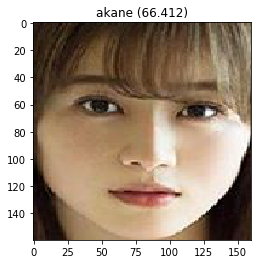

Predicted: rika (59.109)
Expected: akane


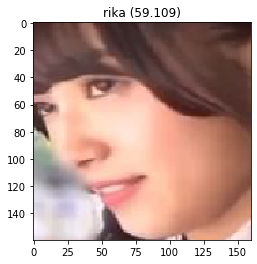

Predicted: akane (94.787)
Expected: akane


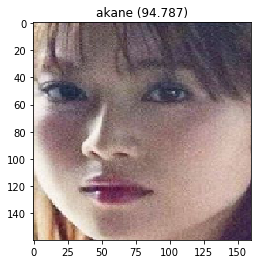

Predicted: rika (42.497)
Expected: akane


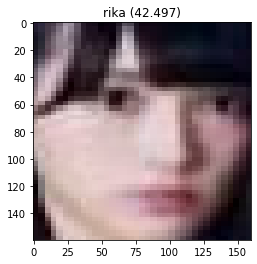

Predicted: rika (34.957)
Expected: akane


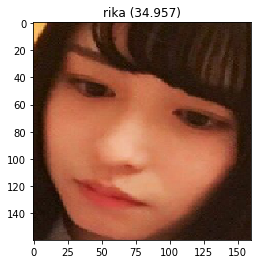

Predicted: yui (38.939)
Expected: akane


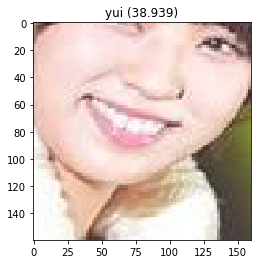

Predicted: neru (90.103)
Expected: akane


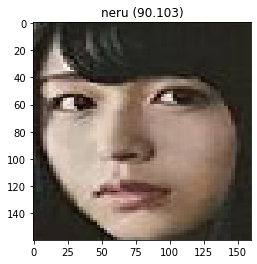

Predicted: rika (58.987)
Expected: akane


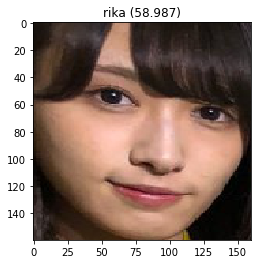

Predicted: yui (28.422)
Expected: akane


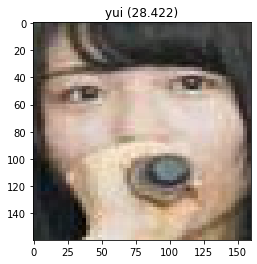

Predicted: neru (84.043)
Expected: akane


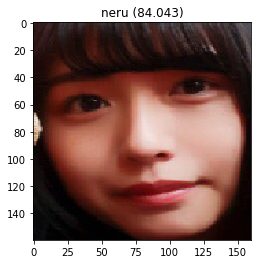

Predicted: yui (45.170)
Expected: akane


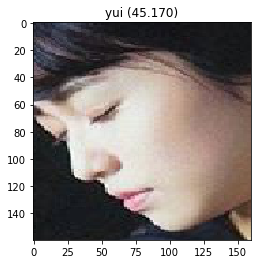

Predicted: neru (75.591)
Expected: akane


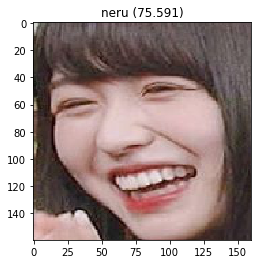

Predicted: neru (87.872)
Expected: akane


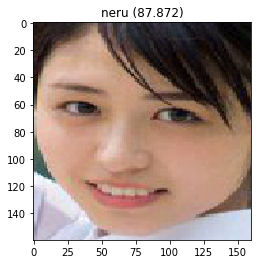

Predicted: neru (72.487)
Expected: akane


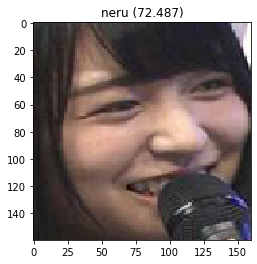

Predicted: rika (40.208)
Expected: akane


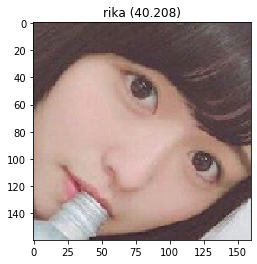

Predicted: neru (75.103)
Expected: akane


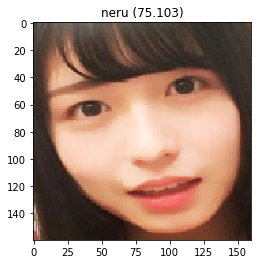

Predicted: neru (84.464)
Expected: akane


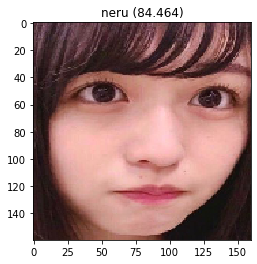

Predicted: yui (76.646)
Expected: akane


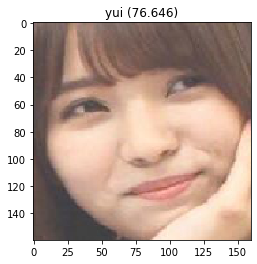

Predicted: akane (88.482)
Expected: akane


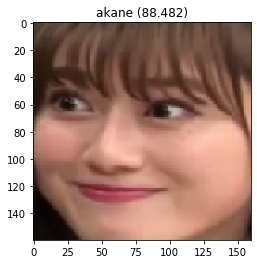

Predicted: yui (63.101)
Expected: akane


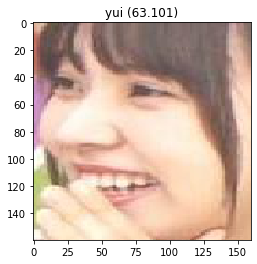

Predicted: rika (52.017)
Expected: akane


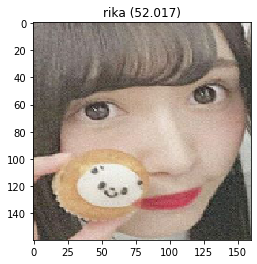

Predicted: akane (81.901)
Expected: akane


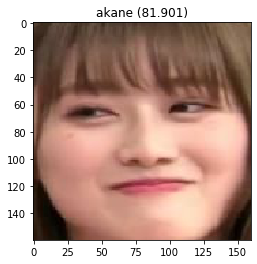

Predicted: yui (91.446)
Expected: akane


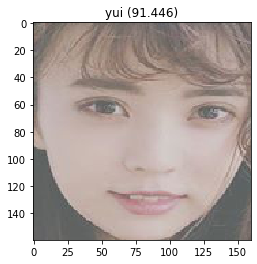

Predicted: neru (82.146)
Expected: akane


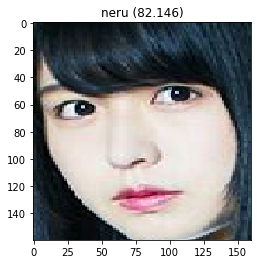

Predicted: yui (37.624)
Expected: akane


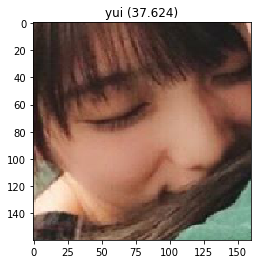

Predicted: neru (80.042)
Expected: akane


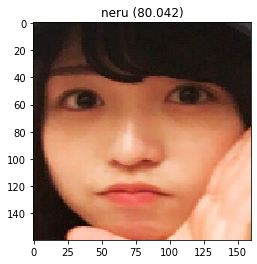

Predicted: akane (72.750)
Expected: akane


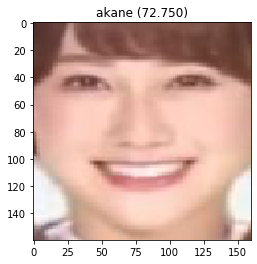

Predicted: neru (87.891)
Expected: akane


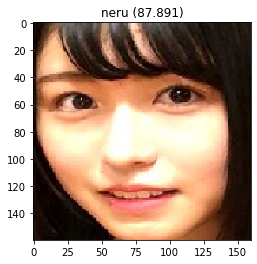

Predicted: neru (68.633)
Expected: akane


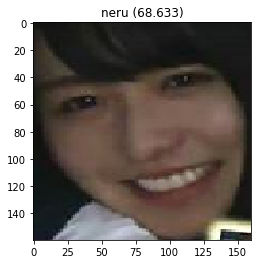

Predicted: rika (63.257)
Expected: akane


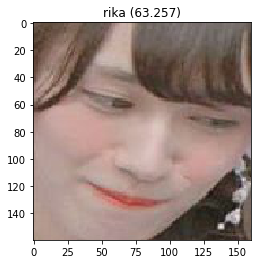

Predicted: risa (35.709)
Expected: akane


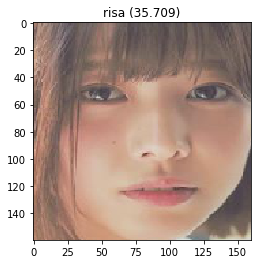

Predicted: neru (92.836)
Expected: akane


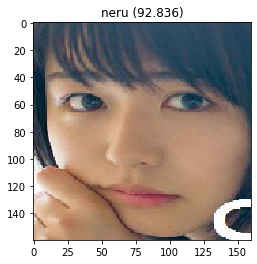

Predicted: akane (46.930)
Expected: akane


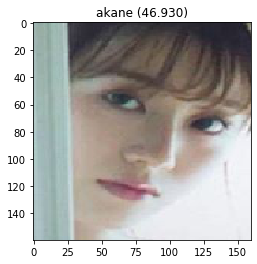

Predicted: yui (85.852)
Expected: akane


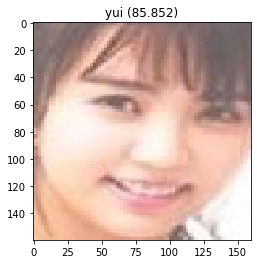

Predicted: neru (62.332)
Expected: akane


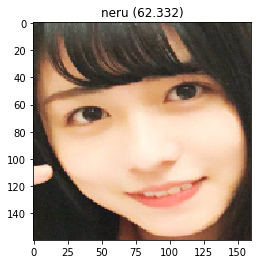

Predicted: neru (77.253)
Expected: akane


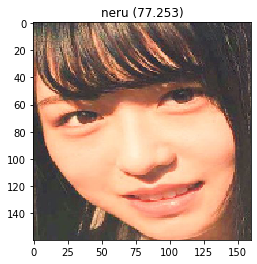

Predicted: rika (44.697)
Expected: akane


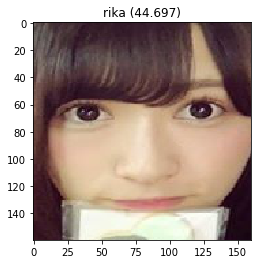

Predicted: yui (72.807)
Expected: akane


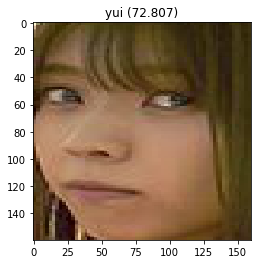

Predicted: neru (92.221)
Expected: akane


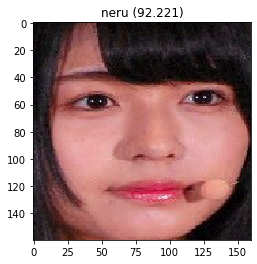

Predicted: neru (32.511)
Expected: akane


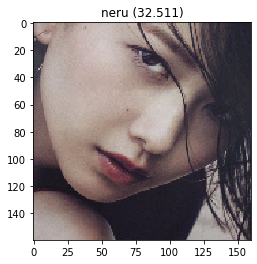

Predicted: akane (50.786)
Expected: akane


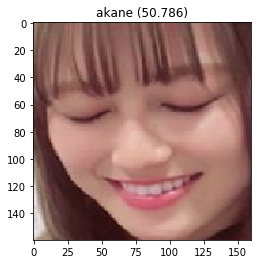

Predicted: yui (40.265)
Expected: akane


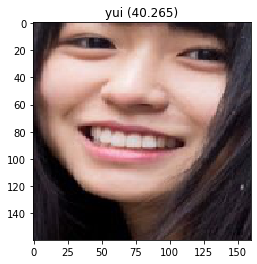

Predicted: neru (43.436)
Expected: akane


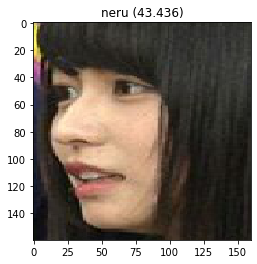

Predicted: risa (45.954)
Expected: akane


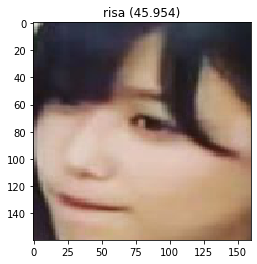

Predicted: neru (81.907)
Expected: akane


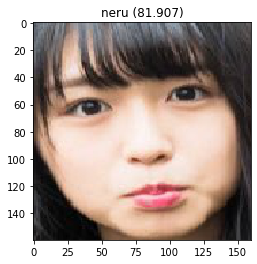

Predicted: akane (37.484)
Expected: akane


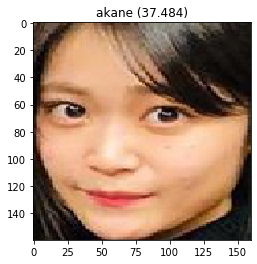

Predicted: akane (88.179)
Expected: akane


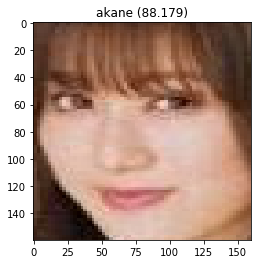

Predicted: akane (81.397)
Expected: akane


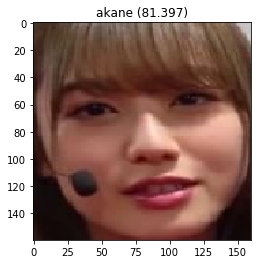

Predicted: neru (53.428)
Expected: akane


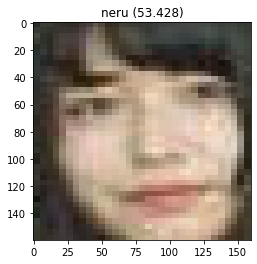

Predicted: akane (69.964)
Expected: akane


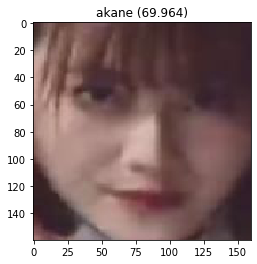

Predicted: neru (89.596)
Expected: akane


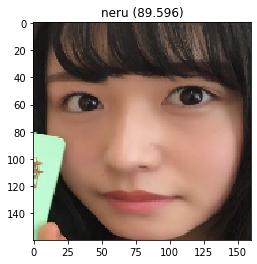

Predicted: neru (73.086)
Expected: akane


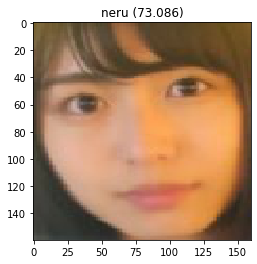

Predicted: akane (65.729)
Expected: akane


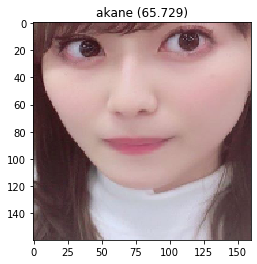

Predicted: akane (70.589)
Expected: akane


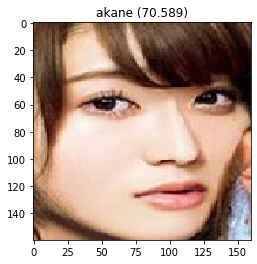

Predicted: akane (92.179)
Expected: akane


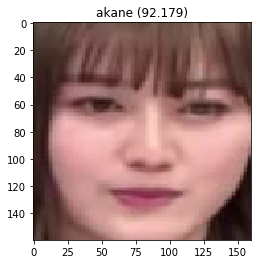

Predicted: akane (96.906)
Expected: akane


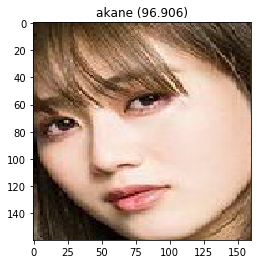

Predicted: akane (85.321)
Expected: akane


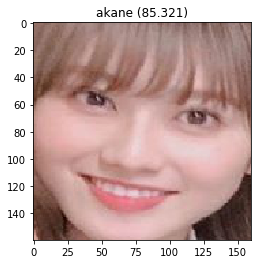

Predicted: neru (88.616)
Expected: akane


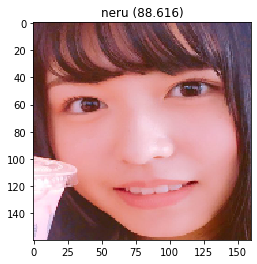

Predicted: rika (80.350)
Expected: akane


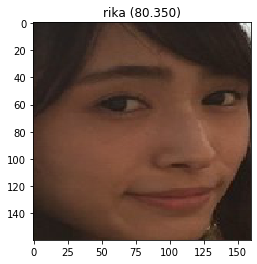

Predicted: rika (63.898)
Expected: akane


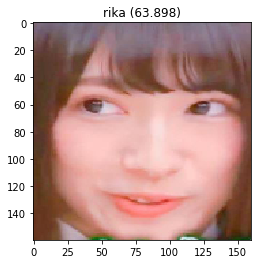

Predicted: yui (75.929)
Expected: akane


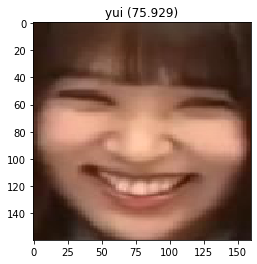

Predicted: rika (82.759)
Expected: akane


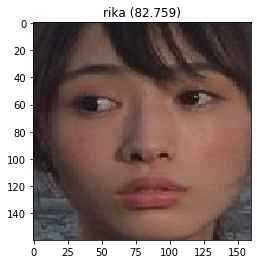

Predicted: rika (56.681)
Expected: akane


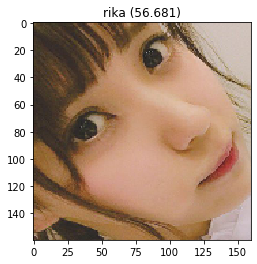

Predicted: rika (69.071)
Expected: akane


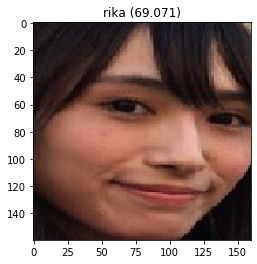

Predicted: rika (76.058)
Expected: akane


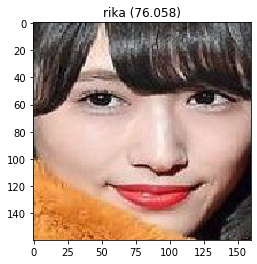

Predicted: yui (78.336)
Expected: akane


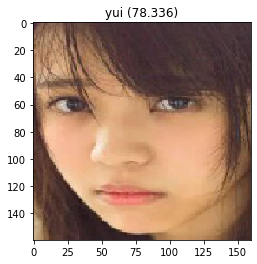

Predicted: rika (57.613)
Expected: akane


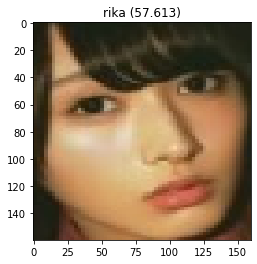

Predicted: neru (48.020)
Expected: akane


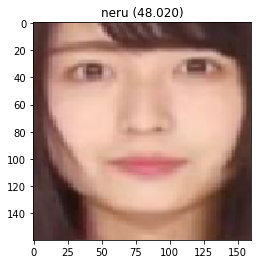

Predicted: risa (83.238)
Expected: akane


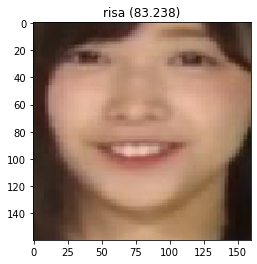

Predicted: akane (91.307)
Expected: akane


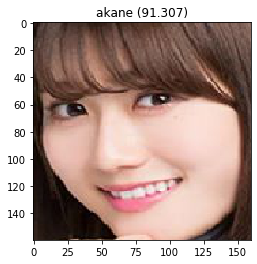

Predicted: yui (96.290)
Expected: akane


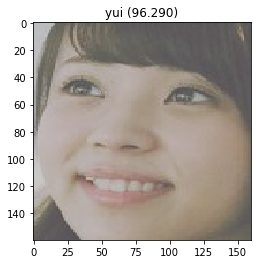

Predicted: yui (68.932)
Expected: akane


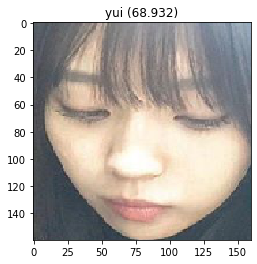

Predicted: rika (37.079)
Expected: akane


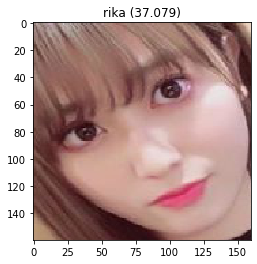

Predicted: risa (58.396)
Expected: akane


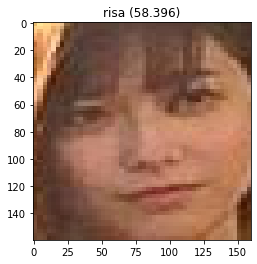

Predicted: yui (71.692)
Expected: akane


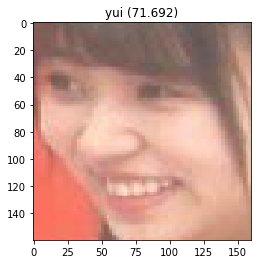

Predicted: rika (84.908)
Expected: akane


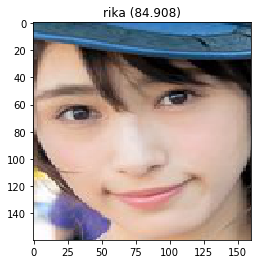

Predicted: neru (83.271)
Expected: akane


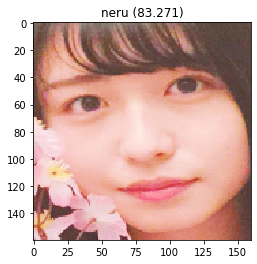

Predicted: rika (75.401)
Expected: akane


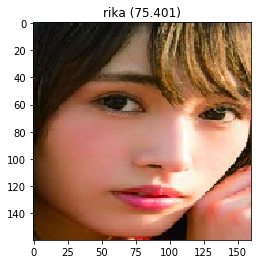

Predicted: neru (88.969)
Expected: akane


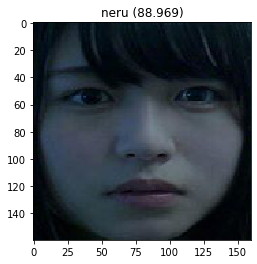

Predicted: neru (56.806)
Expected: akane


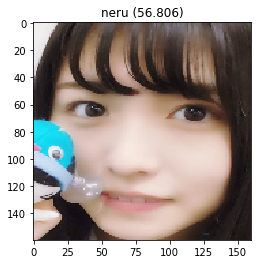

Predicted: neru (74.532)
Expected: akane


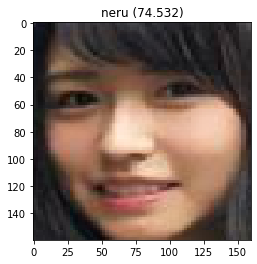

Predicted: akane (73.164)
Expected: akane


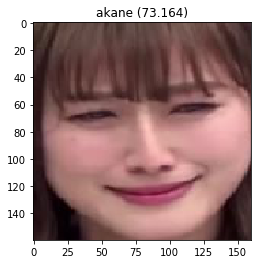

Predicted: risa (97.273)
Expected: akane


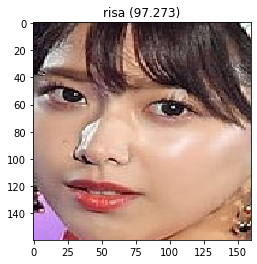

Predicted: akane (49.728)
Expected: akane


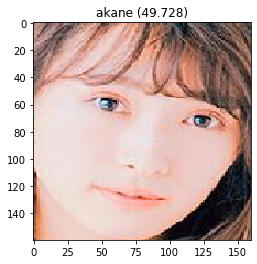

Predicted: akane (31.226)
Expected: akane


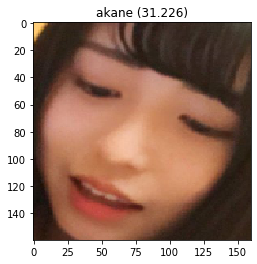

Predicted: neru (85.067)
Expected: akane


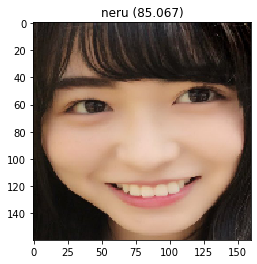

Predicted: neru (85.241)
Expected: akane


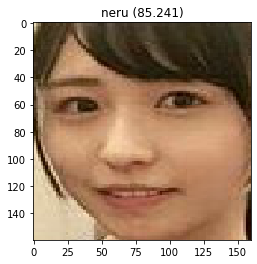

Predicted: akane (91.179)
Expected: akane


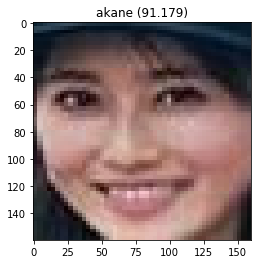

Predicted: rika (60.824)
Expected: akane


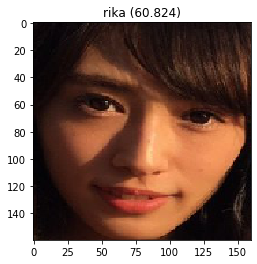

Predicted: yui (93.815)
Expected: akane


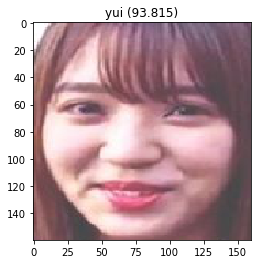

Predicted: neru (66.942)
Expected: akane


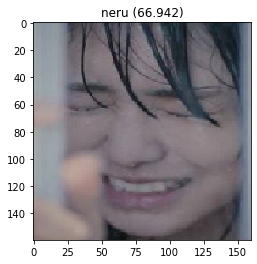

Predicted: neru (81.488)
Expected: akane


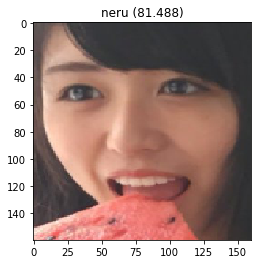

Predicted: akane (88.002)
Expected: akane


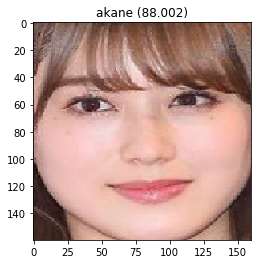

Predicted: neru (80.524)
Expected: akane


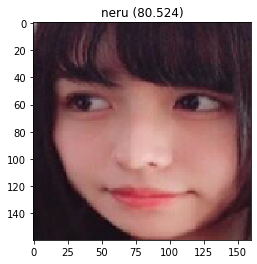

Predicted: neru (68.777)
Expected: akane


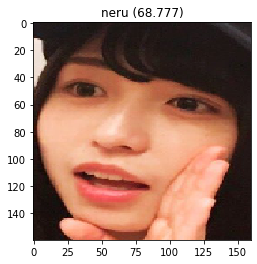

Predicted: akane (81.408)
Expected: akane


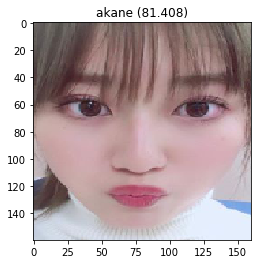

Predicted: neru (89.124)
Expected: akane


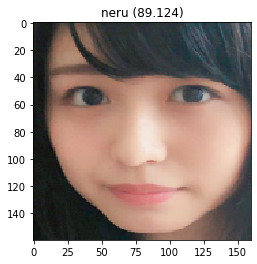

Predicted: rika (50.937)
Expected: akane


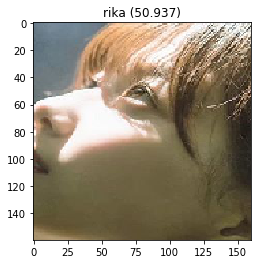

Predicted: yui (60.879)
Expected: akane


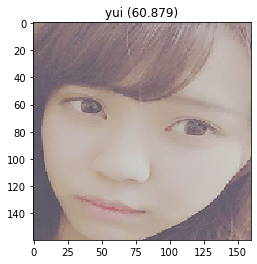

Predicted: neru (76.926)
Expected: akane


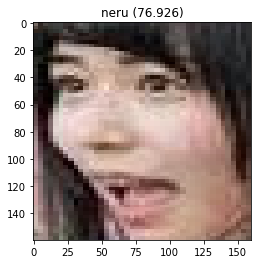

Predicted: rika (88.013)
Expected: akane


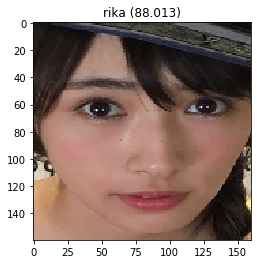

Predicted: rika (55.887)
Expected: akane


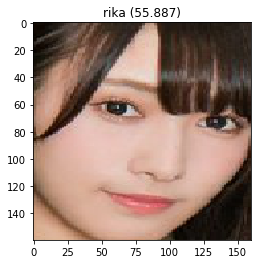

Predicted: rika (91.017)
Expected: akane


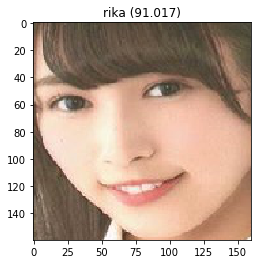

Predicted: akane (68.018)
Expected: akane


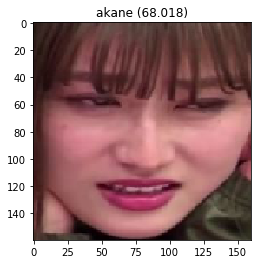

Predicted: akane (60.573)
Expected: akane


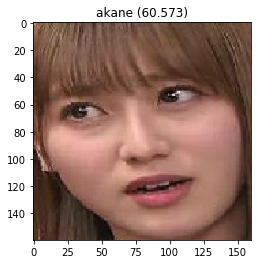

Predicted: neru (53.503)
Expected: akane


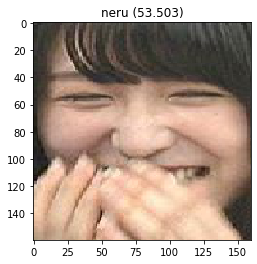

Predicted: risa (97.415)
Expected: akane


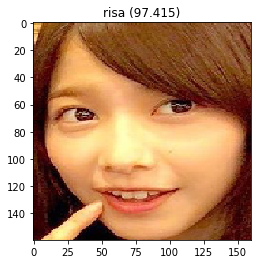

Predicted: rika (42.480)
Expected: akane


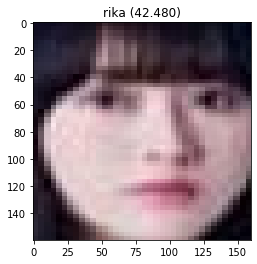

Predicted: yui (44.013)
Expected: akane


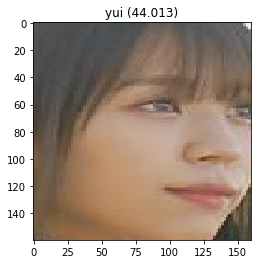

Predicted: rika (41.327)
Expected: akane


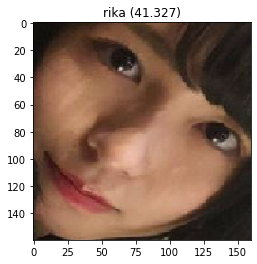

Predicted: neru (45.210)
Expected: akane


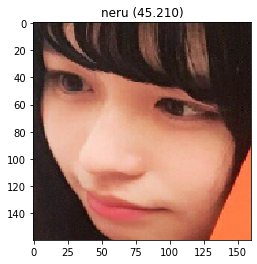

Predicted: akane (81.397)
Expected: akane


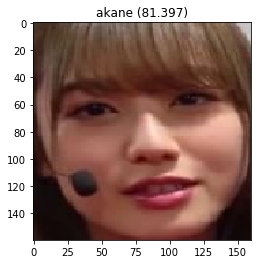

Predicted: yui (74.643)
Expected: akane


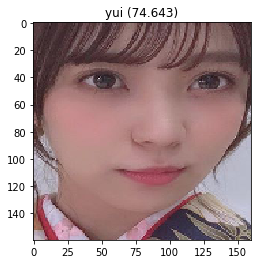

Predicted: neru (89.084)
Expected: akane


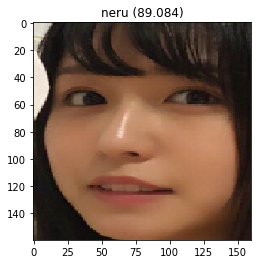

Predicted: akane (90.092)
Expected: akane


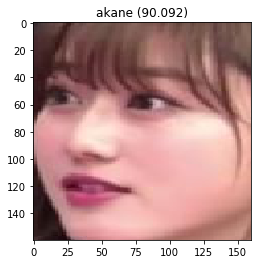

Predicted: akane (62.029)
Expected: akane


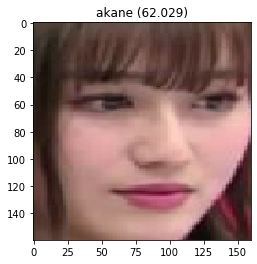

Predicted: yui (90.325)
Expected: akane


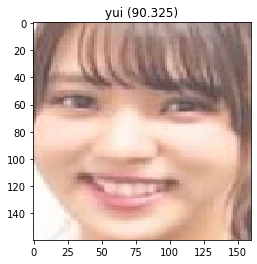

Predicted: yui (49.217)
Expected: akane


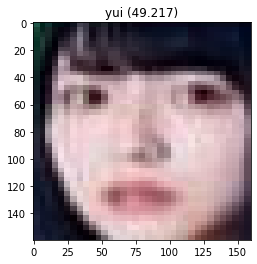

Predicted: yui (85.879)
Expected: akane


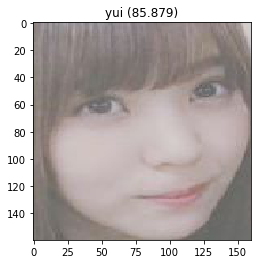

Predicted: rika (32.229)
Expected: akane


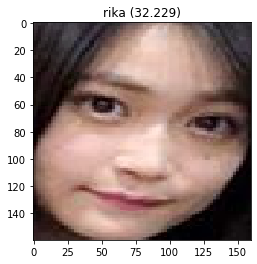

Predicted: rika (63.439)
Expected: akane


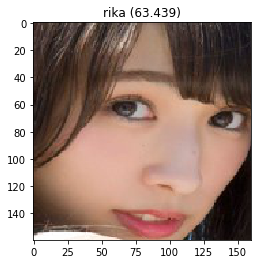

Predicted: neru (71.333)
Expected: akane


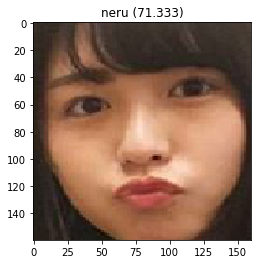

Predicted: rika (80.411)
Expected: akane


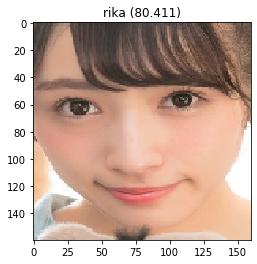

Predicted: yui (93.694)
Expected: akane


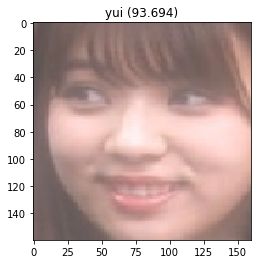

Predicted: akane (95.049)
Expected: akane


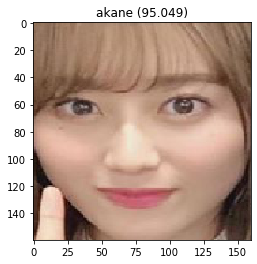

Predicted: neru (89.259)
Expected: akane


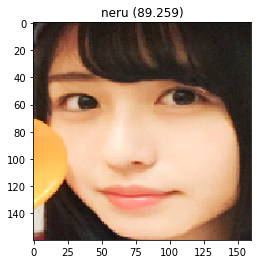

Predicted: yui (91.474)
Expected: akane


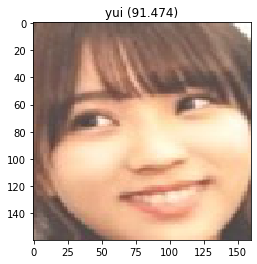

Predicted: yui (92.709)
Expected: akane


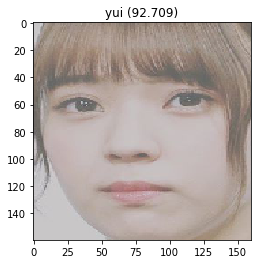

Predicted: risa (86.461)
Expected: akane


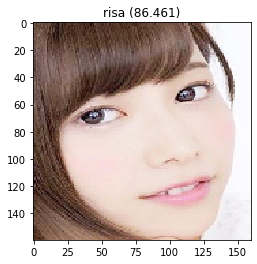

Predicted: yui (90.310)
Expected: akane


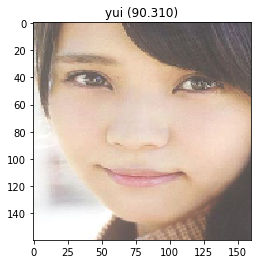

Predicted: neru (70.483)
Expected: akane


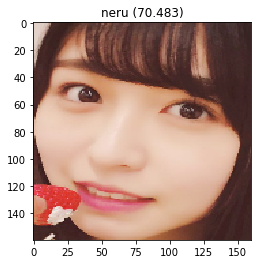

Predicted: yui (95.411)
Expected: akane


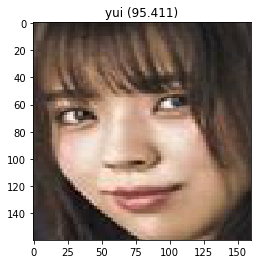

Predicted: yui (96.973)
Expected: akane


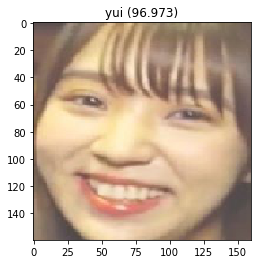

Predicted: risa (95.496)
Expected: akane


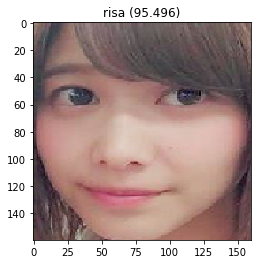

Predicted: risa (50.586)
Expected: akane


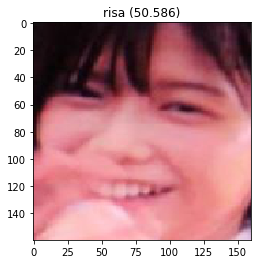

Predicted: rika (67.803)
Expected: akane


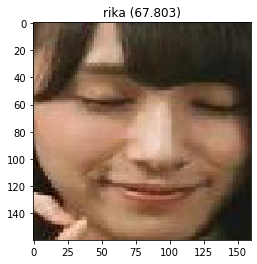

Predicted: risa (50.247)
Expected: akane


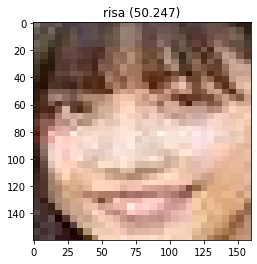

Predicted: neru (85.305)
Expected: akane


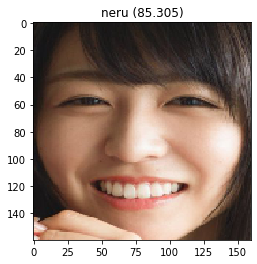

Predicted: akane (72.928)
Expected: akane


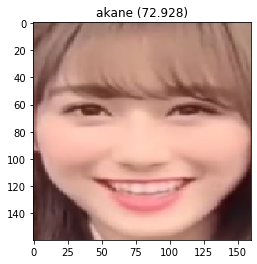

Predicted: akane (81.801)
Expected: akane


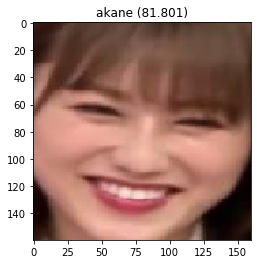

Predicted: neru (69.977)
Expected: akane


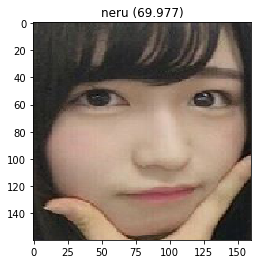

Predicted: risa (40.282)
Expected: akane


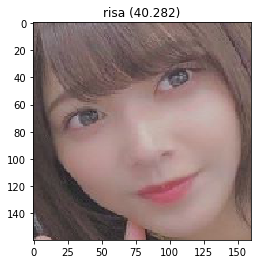

Predicted: risa (87.349)
Expected: akane


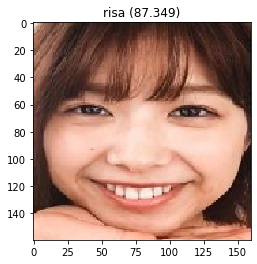

Predicted: rika (44.331)
Expected: akane


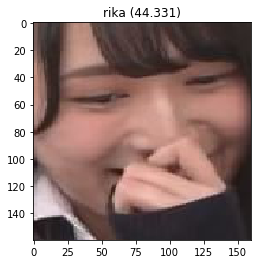

Predicted: neru (90.602)
Expected: akane


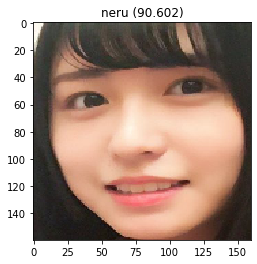

Predicted: yui (85.768)
Expected: akane


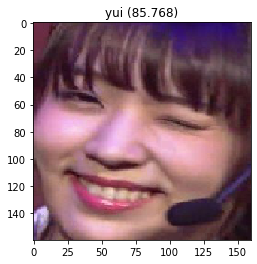

Predicted: akane (74.296)
Expected: akane


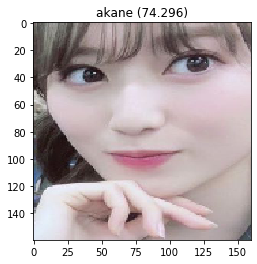

Predicted: neru (63.931)
Expected: akane


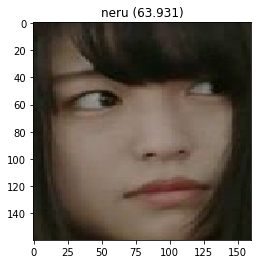

Predicted: rika (84.345)
Expected: akane


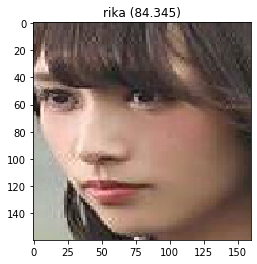

Predicted: risa (85.557)
Expected: akane


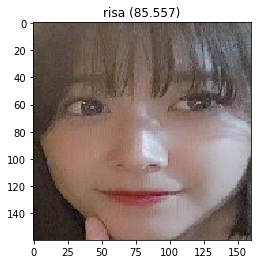

Predicted: neru (43.078)
Expected: akane


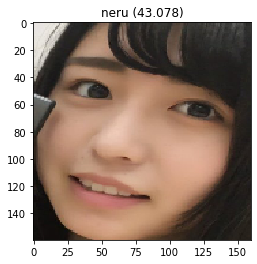

Predicted: neru (72.665)
Expected: akane


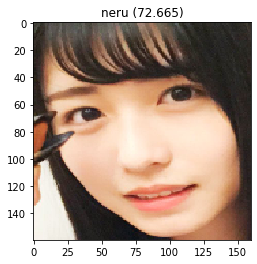

Predicted: yui (35.740)
Expected: akane


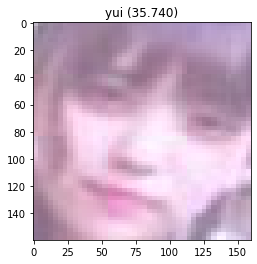

Predicted: rika (51.301)
Expected: akane


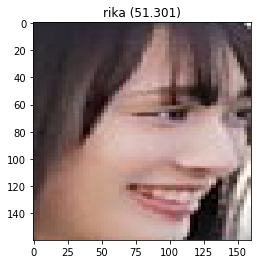

Predicted: akane (77.873)
Expected: akane


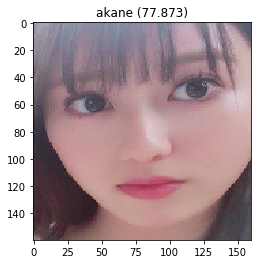

Predicted: akane (46.930)
Expected: akane


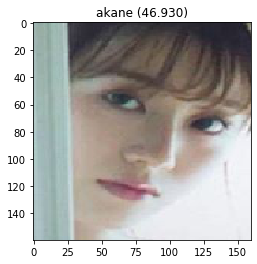

Predicted: yui (61.062)
Expected: akane


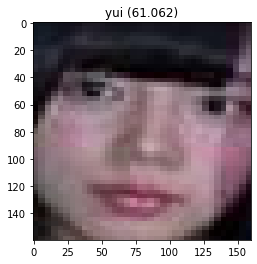

Predicted: risa (80.096)
Expected: akane


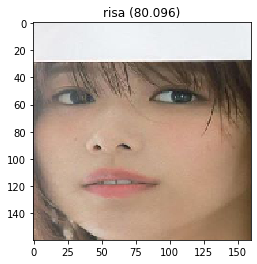

Predicted: risa (97.296)
Expected: akane


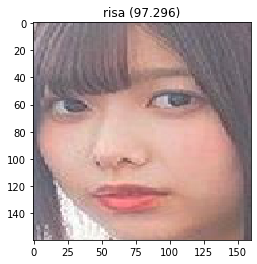

Predicted: risa (96.577)
Expected: akane


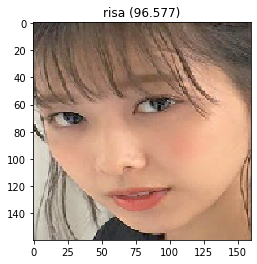

Predicted: neru (78.846)
Expected: akane


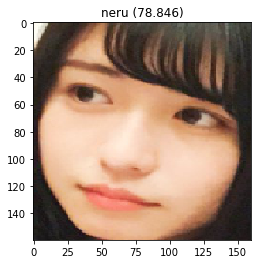

Predicted: risa (95.055)
Expected: akane


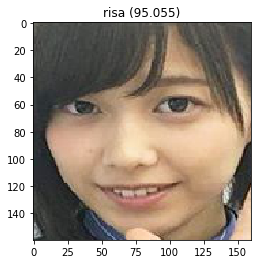

Predicted: akane (89.376)
Expected: akane


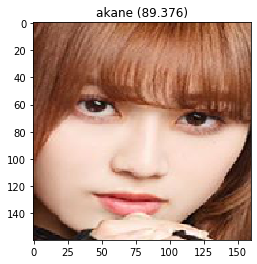

Predicted: akane (83.965)
Expected: akane


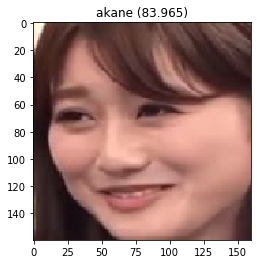

Predicted: neru (79.401)
Expected: akane


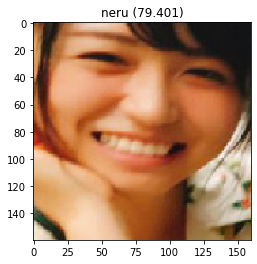

Predicted: akane (86.325)
Expected: akane


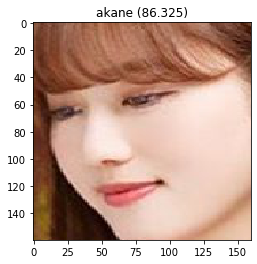

Predicted: neru (41.929)
Expected: akane


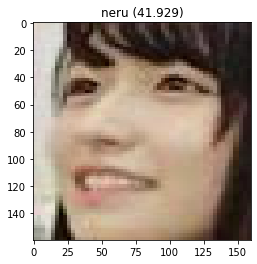

Predicted: akane (44.179)
Expected: akane


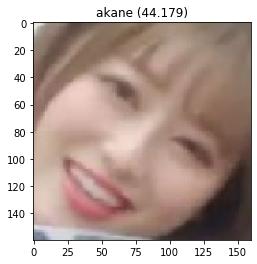

Predicted: yui (82.452)
Expected: akane


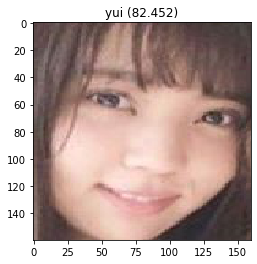

Predicted: yui (79.462)
Expected: akane


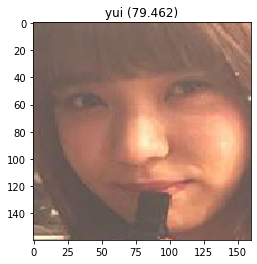

Predicted: rika (72.659)
Expected: akane


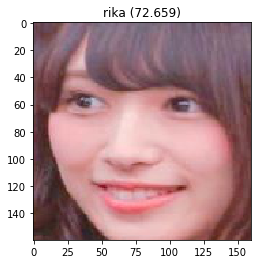

Predicted: akane (92.610)
Expected: akane


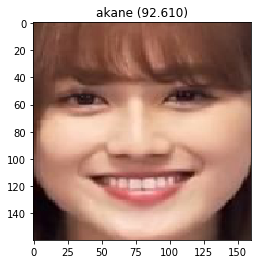

Predicted: neru (66.266)
Expected: akane


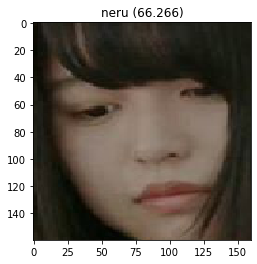

Predicted: rika (50.523)
Expected: akane


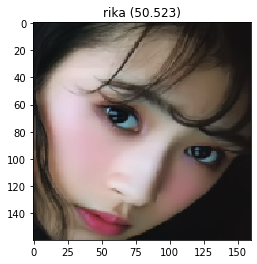

Predicted: neru (76.999)
Expected: akane


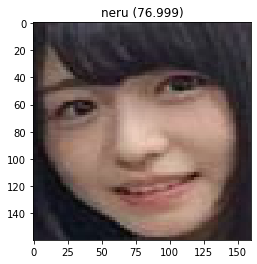

Predicted: rika (68.428)
Expected: akane


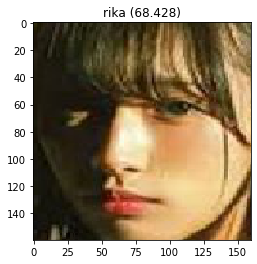

Predicted: neru (72.284)
Expected: akane


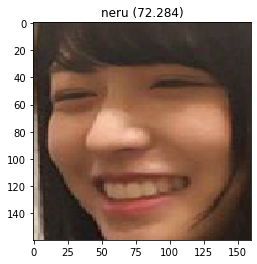

Predicted: risa (82.540)
Expected: akane


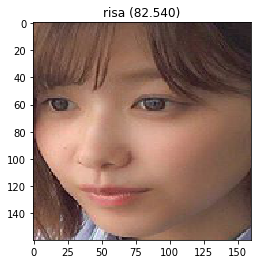

Predicted: rika (29.726)
Expected: akane


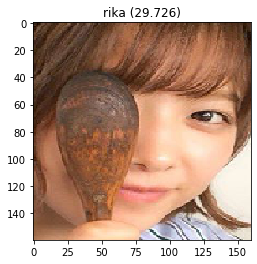

Predicted: risa (97.770)
Expected: akane


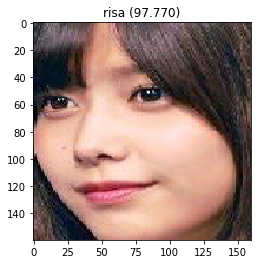

Predicted: akane (57.040)
Expected: akane


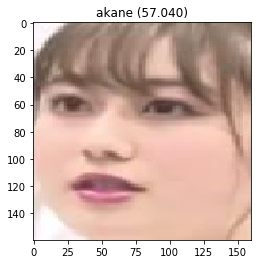

Predicted: risa (97.704)
Expected: akane


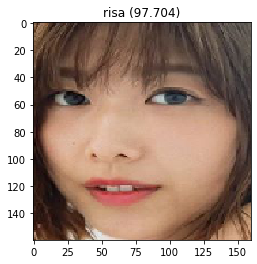

Predicted: risa (92.108)
Expected: akane


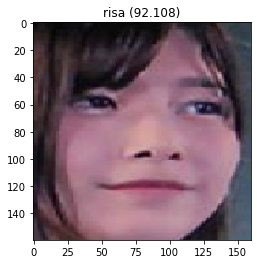

Predicted: risa (82.008)
Expected: akane


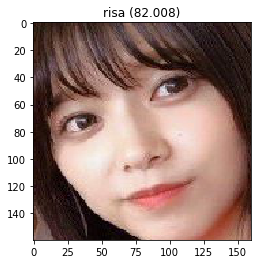

Predicted: risa (92.518)
Expected: akane


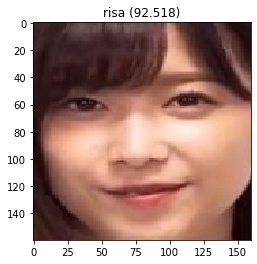

Predicted: rika (92.245)
Expected: akane


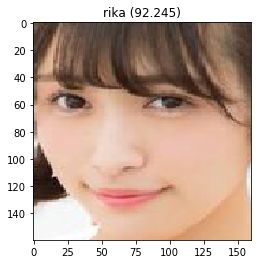

Predicted: rika (44.247)
Expected: akane


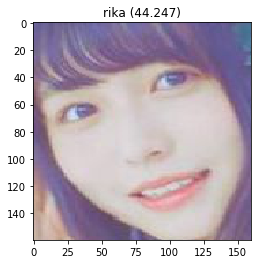

Predicted: yui (53.099)
Expected: akane


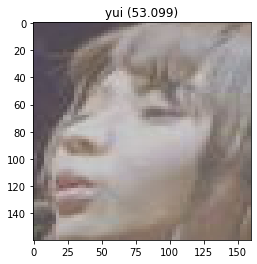

Predicted: neru (39.413)
Expected: akane


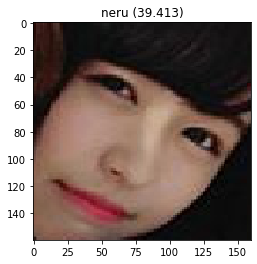

Predicted: yui (90.904)
Expected: akane


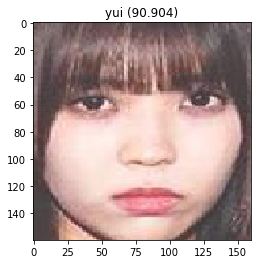

Predicted: rika (81.357)
Expected: akane


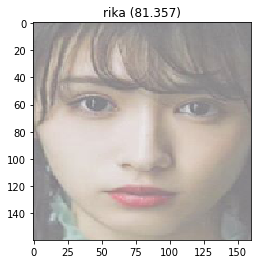

Predicted: rika (65.611)
Expected: akane


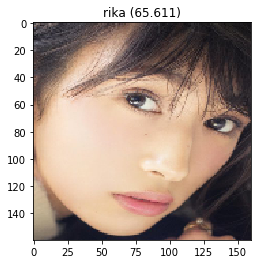

Predicted: risa (80.577)
Expected: akane


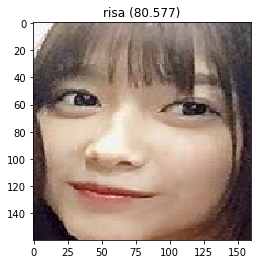

Predicted: risa (79.387)
Expected: akane


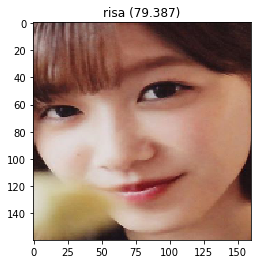

Predicted: rika (49.743)
Expected: akane


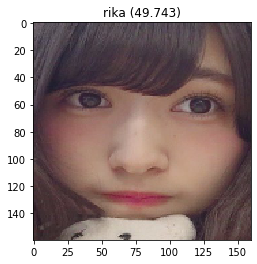

Predicted: rika (68.342)
Expected: akane


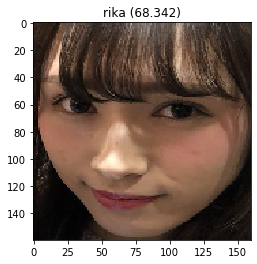

Predicted: rika (55.365)
Expected: akane


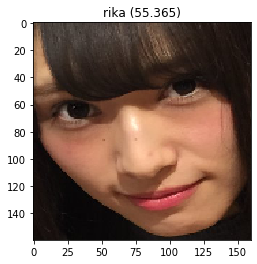

Predicted: akane (94.807)
Expected: akane


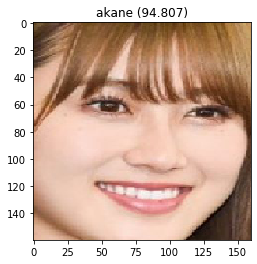

Predicted: yui (41.600)
Expected: akane


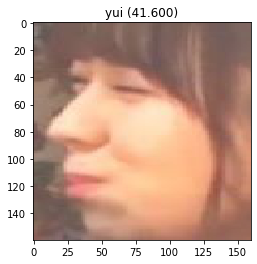

Predicted: yui (88.888)
Expected: akane


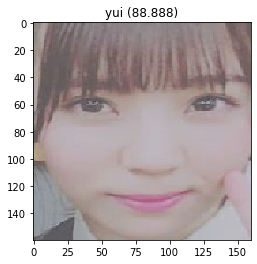

Predicted: risa (94.603)
Expected: akane


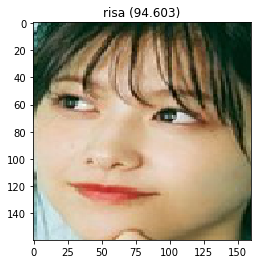

Predicted: yui (83.173)
Expected: akane


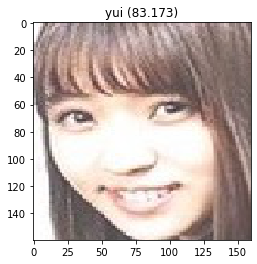

Predicted: rika (42.104)
Expected: akane


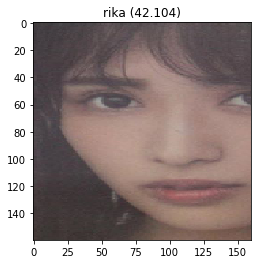

Predicted: risa (87.240)
Expected: akane


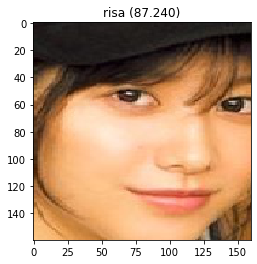

Predicted: neru (70.625)
Expected: akane


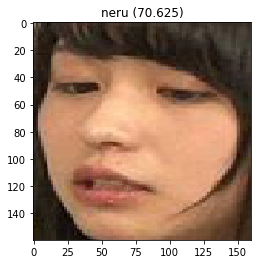

Predicted: neru (79.046)
Expected: akane


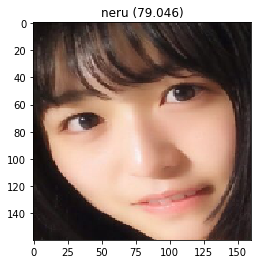

Predicted: risa (58.501)
Expected: akane


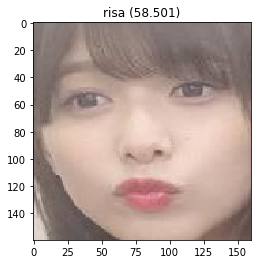

Predicted: akane (88.968)
Expected: akane


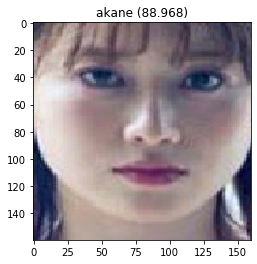

Predicted: neru (82.983)
Expected: akane


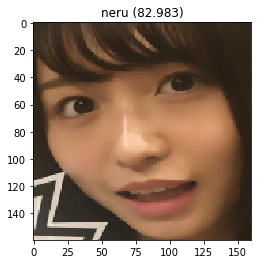

Predicted: yui (94.022)
Expected: akane


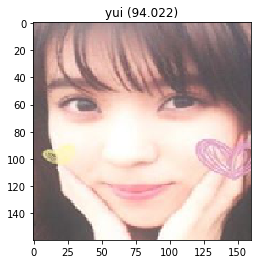

Predicted: akane (88.002)
Expected: akane


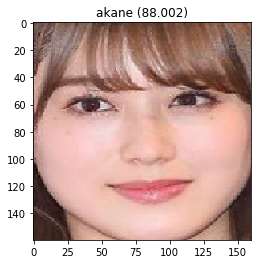

Predicted: neru (75.745)
Expected: akane


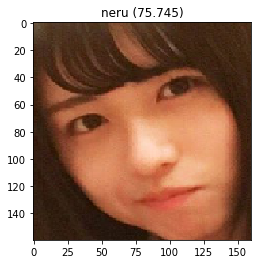

Predicted: yui (90.702)
Expected: akane


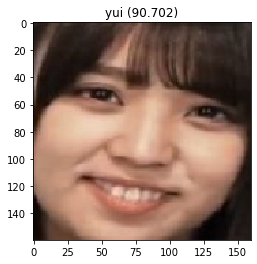

Predicted: rika (76.419)
Expected: akane


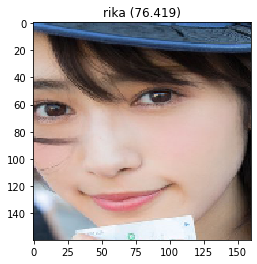

Predicted: neru (87.581)
Expected: akane


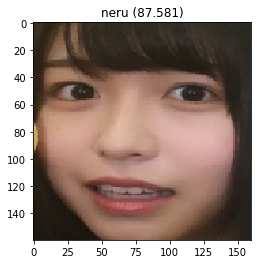

Predicted: neru (91.304)
Expected: akane


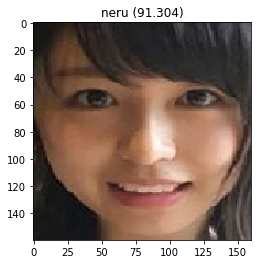

Predicted: akane (95.512)
Expected: akane


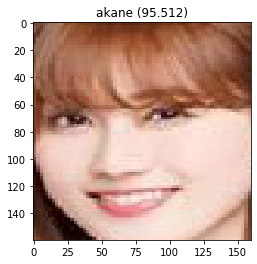

Predicted: neru (86.233)
Expected: akane


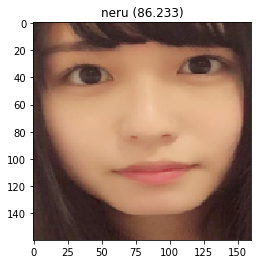

Predicted: neru (72.893)
Expected: akane


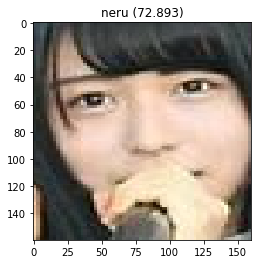

Predicted: neru (72.166)
Expected: akane


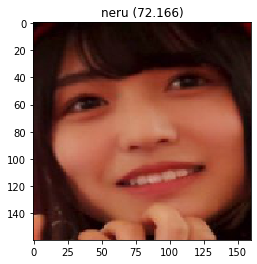

Predicted: neru (80.323)
Expected: akane


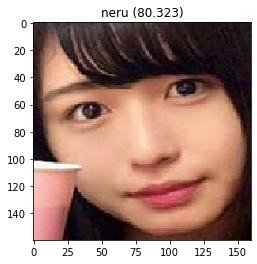

Predicted: neru (58.048)
Expected: akane


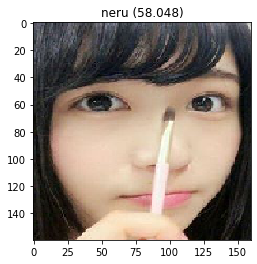

Predicted: akane (89.028)
Expected: akane


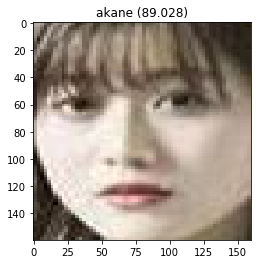

Predicted: neru (62.810)
Expected: akane


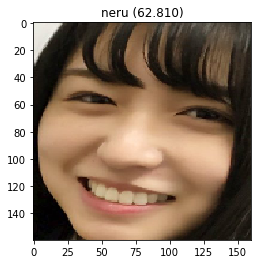

Predicted: rika (70.611)
Expected: akane


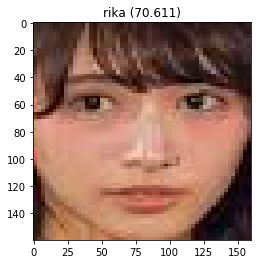

Predicted: risa (26.297)
Expected: akane


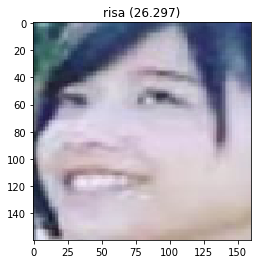

Predicted: neru (38.511)
Expected: akane


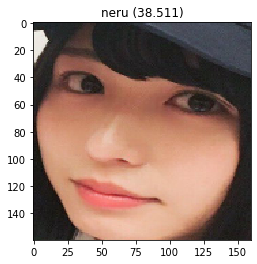

Predicted: akane (57.040)
Expected: akane


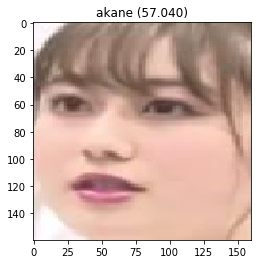

Predicted: rika (34.074)
Expected: akane


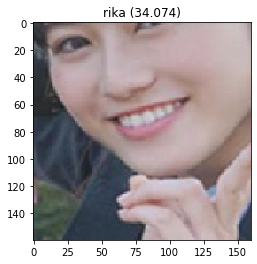

Predicted: neru (87.621)
Expected: akane


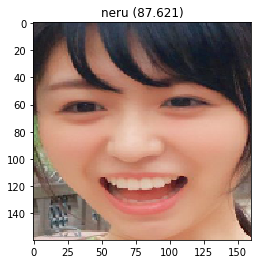

Predicted: yui (34.956)
Expected: akane


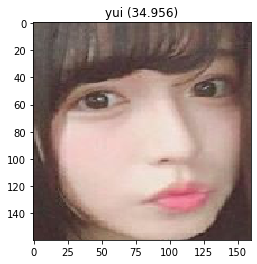

Predicted: neru (82.325)
Expected: akane


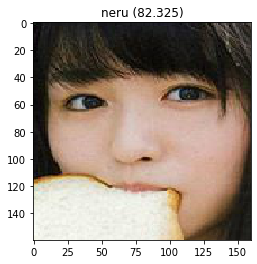

Predicted: rika (49.537)
Expected: akane


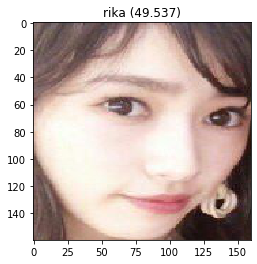

Predicted: yui (75.915)
Expected: akane


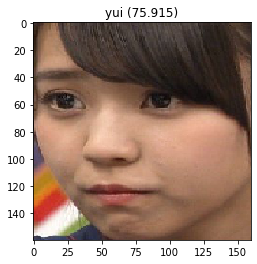

Predicted: rika (63.675)
Expected: akane


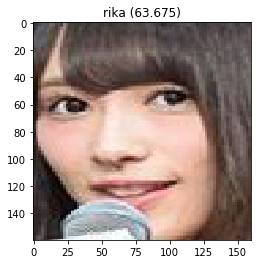

Predicted: yui (79.520)
Expected: akane


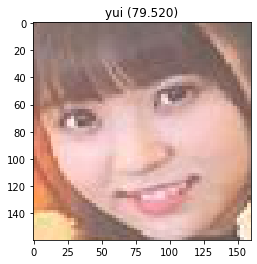

Predicted: neru (80.937)
Expected: akane


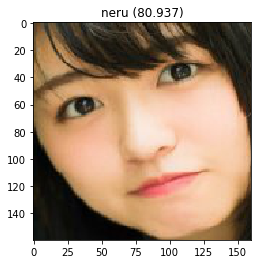

Predicted: risa (42.248)
Expected: akane


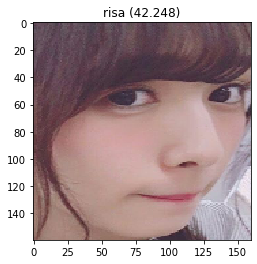

Predicted: akane (85.229)
Expected: akane


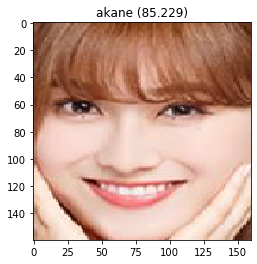

Predicted: neru (95.898)
Expected: akane


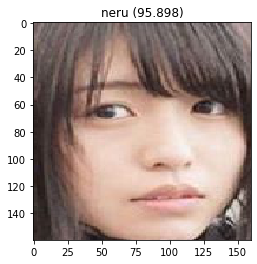

Predicted: yui (73.032)
Expected: akane


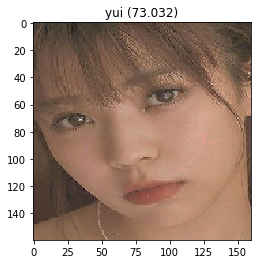

Predicted: akane (91.179)
Expected: akane


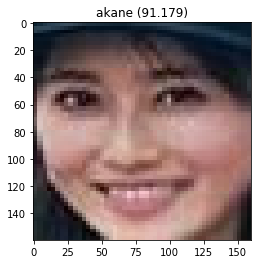

Predicted: risa (81.233)
Expected: akane


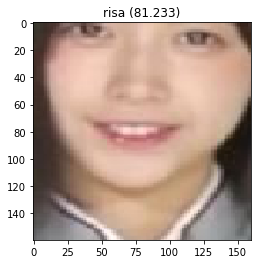

Predicted: yui (91.671)
Expected: akane


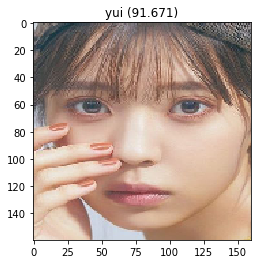

Predicted: rika (55.527)
Expected: akane


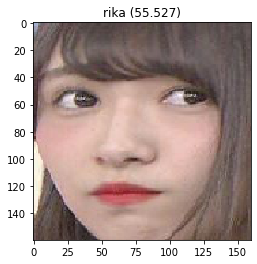

Predicted: yui (32.804)
Expected: akane


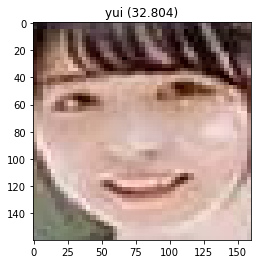

Predicted: risa (82.637)
Expected: akane


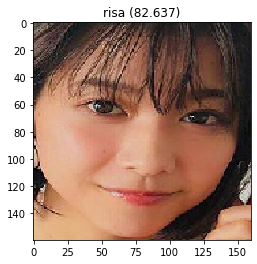

Predicted: risa (72.921)
Expected: akane


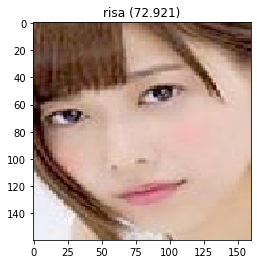

Predicted: rika (66.884)
Expected: akane


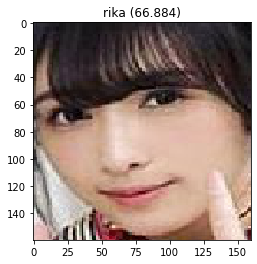

Predicted: neru (90.054)
Expected: akane


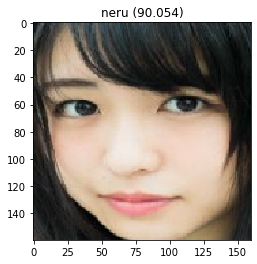

Predicted: yui (91.379)
Expected: akane


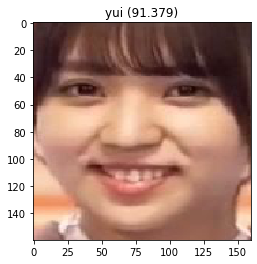

Predicted: risa (81.100)
Expected: akane


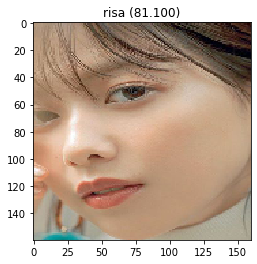

Predicted: yui (84.630)
Expected: akane


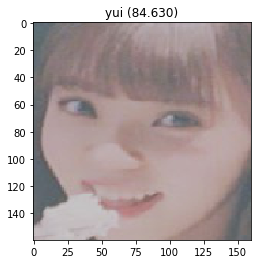

Predicted: yui (91.170)
Expected: akane


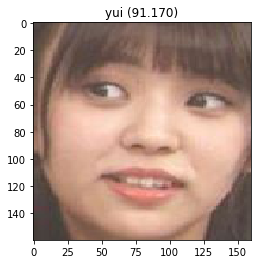

Predicted: yui (43.906)
Expected: akane


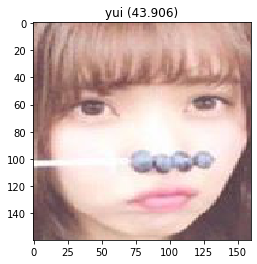

Predicted: akane (76.113)
Expected: akane


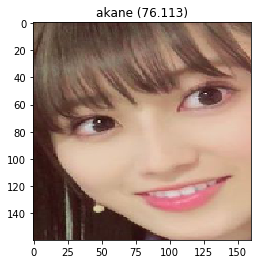

Predicted: rika (64.344)
Expected: akane


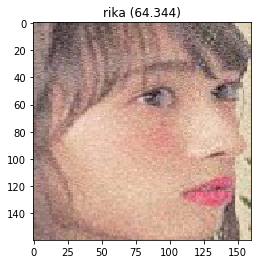

Predicted: yui (86.247)
Expected: akane


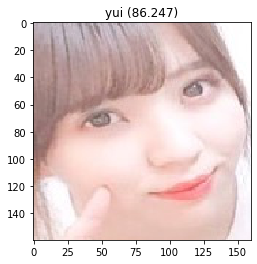

Predicted: rika (55.325)
Expected: akane


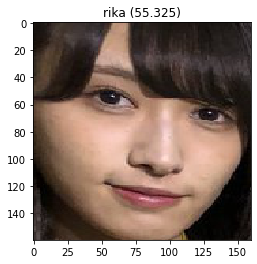

Predicted: risa (39.042)
Expected: akane


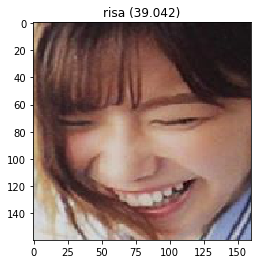

Predicted: rika (37.392)
Expected: akane


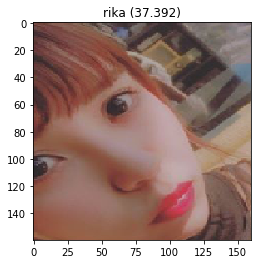

Predicted: neru (86.361)
Expected: akane


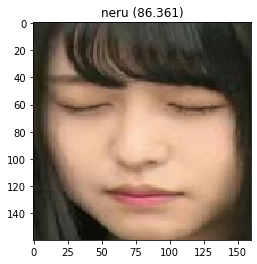

Predicted: risa (56.524)
Expected: akane


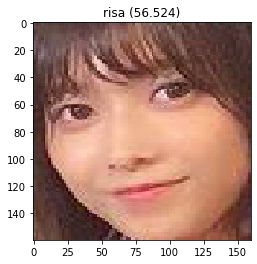

Predicted: neru (92.732)
Expected: akane


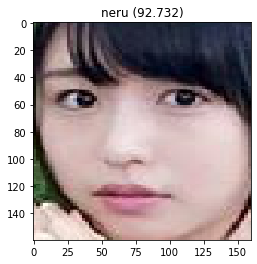

Predicted: risa (94.845)
Expected: akane


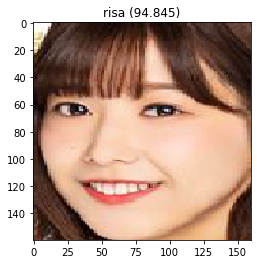

Predicted: risa (65.270)
Expected: akane


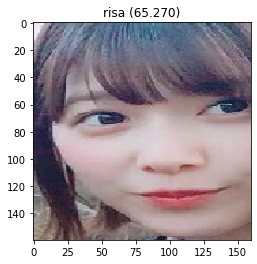

Predicted: akane (66.614)
Expected: akane


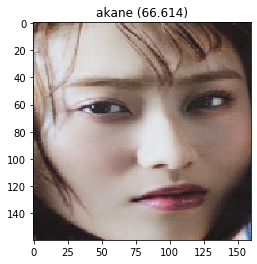

Predicted: yui (81.545)
Expected: akane


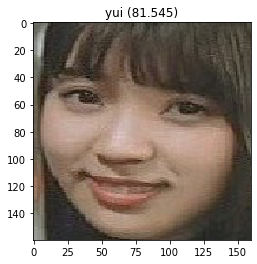

Predicted: neru (90.708)
Expected: akane


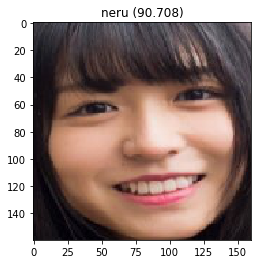

Predicted: neru (56.900)
Expected: akane


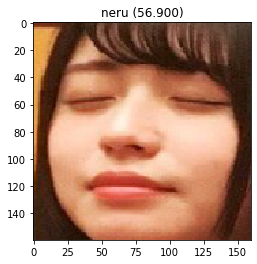

Predicted: akane (92.502)
Expected: akane


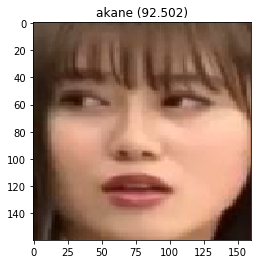

Predicted: neru (86.448)
Expected: akane


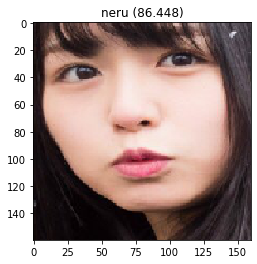

Predicted: rika (73.007)
Expected: akane


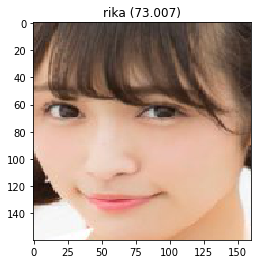

Predicted: risa (95.434)
Expected: akane


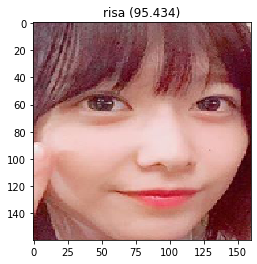

Predicted: rika (82.888)
Expected: akane


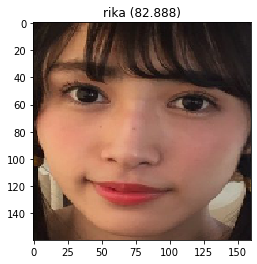

Predicted: neru (83.150)
Expected: akane


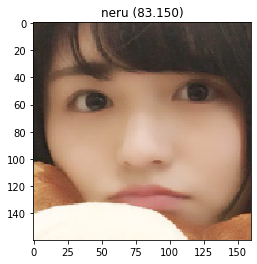

Predicted: risa (94.575)
Expected: akane


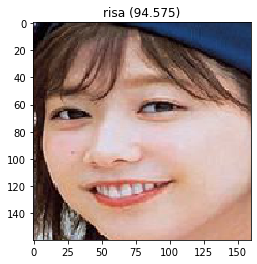

Predicted: akane (68.637)
Expected: akane


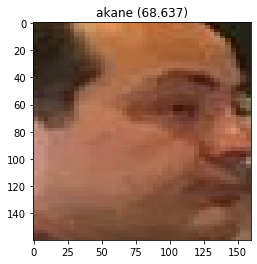

Predicted: yui (86.693)
Expected: akane


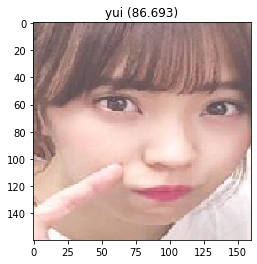

In [21]:
import warnings
warnings.filterwarnings(action='ignore', category=DeprecationWarning)
#for selection in range(len(testX_faces)):
78
listc = []
for  i  in  range(testX.shape[0]):
    selection = i
            # test model on a random example from the test dataset
    #selection  =  choice([i  for  i  in  range(testX.shape[0])])
    #selection = 1 #
    random_face_pixels  =  testX_faces[selection] #資料的圓形
    random_face_emb  =  testX[selection] #資料的臉
    random_face_class  =  testy[selection]
    random_face_name  =  out_encoder.inverse_transform([random_face_class])
    # prediction for the face
    samples  =  expand_dims(random_face_emb,  axis=0)
    yhat_class  =  model.predict(samples)
    yhat_prob  =  model.predict_proba(samples)
    # get name
    class_index  =  yhat_class[0]
    class_probability  =  yhat_prob[0,class_index]  *  100
    predict_names  =  out_encoder.inverse_transform(yhat_class)
    print('Predicted: %s (%.3f)'  %  (predict_names[0],  class_probability))
    print('Expected: %s'  %  random_face_name[0])
    
    #產生預測資料列表
    listc.append(predict_names[0])
    
    pyplot.imshow(random_face_pixels)
    title  =  '%s (%.3f)'  %  (predict_names[0],  class_probability)
    pyplot.title(title)
    pyplot.show()


## 2.將前一步驟的預測列表整理成指定的格式
1.合併影像名稱與預測類別 <br>
2.處理例外資料(隨機補值) <br>
3.合併預測資料與例外資料 <br>

In [22]:
print('\n合併影像名稱與預測類別')
print(len(listc))
df = pd.DataFrame(list_file)
df2 = pd.DataFrame(listc)
df =pd.concat([df,df2], axis = 1)
print(df.head())
#df.to_csv('result1.csv',index=False )

print('\n處理例外資料(隨機補值)')
except_list = []
for _ in range(len(list_except_file)):
    selection  =  choice([i  for  i  in  range(trainX.shape[0])])
    random_class  =  trainy[selection]
    random_class  =  out_encoder.inverse_transform([random_class])
    except_list.append(random_class[0])
df_except = pd.DataFrame(list_except_file)
df_except_class = pd.DataFrame(except_list)
df_except = pd.concat([df_except, df_except_class], axis = 1)
print('[%d]'%len(df_except))
print(df_except)

print('\n合併預測資料與例外資料')
df = pd.concat([df,df_except], axis = 0)
print(df)
#df.to_csv('result1.csv',index=False )


合併影像名稱與預測類別
430
            0      0
0  7B0702E9FD    yui
1  43A15DDE89  akane
2  E6A9AED5E7  akane
3  36063E5BF3  akane
4  6F359C960F   rika

處理例外資料(隨機補值)
[8]
            0      0
0  46F41217A1   rika
1  006F8606F6  akane
2  CF26F3A06A   rika
3  C415C04F50  akane
4  DE293981F6   neru
5  94CFFD34C6  akane
6  987B12DA46  akane
7  7350B1E247    yui

合併預測資料與例外資料
             0      0
0   7B0702E9FD    yui
1   43A15DDE89  akane
2   E6A9AED5E7  akane
3   36063E5BF3  akane
4   6F359C960F   rika
..         ...    ...
3   C415C04F50  akane
4   DE293981F6   neru
5   94CFFD34C6  akane
6   987B12DA46  akane
7   7350B1E247    yui

[438 rows x 2 columns]


# 輸出預測結果

## 1.依據classmap將預測類別的字串進行轉換

In [23]:
#原始資料
print('原始預測列表')
print(df.head(3))


#讀取SampleSubmission，尋找指定的Column name
print('根據指定的格式更改Column name')
dfSampleSubmission = pd.read_csv('./sample_submission.csv')
a = dfSampleSubmission.columns[0]
b = dfSampleSubmission.columns[1]
#更改Column name為指定的樣式
df.columns=[a, b]
print(df.head(3))
print('-----------')

#讀取ClassMap
print('依據Classmap做classnum的數值化轉換')
dfClassMap = pd.read_csv('./classmap.csv')
#用for迴圈把原始資料的class依據ClassMap做數值轉換
for _ in range(len(dfClassMap)):
    a = str(dfClassMap.loc[_]['classname'])
    b = str(dfClassMap.loc[_]['classnum'])
    df['class'] = df['class'].str.replace(a,b)
    
# 顯示修改後的資料
print(df.head(3))

原始預測列表
            0      0
0  7B0702E9FD    yui
1  43A15DDE89  akane
2  E6A9AED5E7  akane
根據指定的格式更改Column name
           id  class
0  7B0702E9FD    yui
1  43A15DDE89  akane
2  E6A9AED5E7  akane
-----------
依據Classmap做classnum的數值化轉換
           id class
0  7B0702E9FD     2
1  43A15DDE89     3
2  E6A9AED5E7     3


## 2.打印結果

In [24]:

df.to_csv('result.csv',index=False)


## 3.結束計時

In [25]:

end = time.time()
print(end - start)

668.7110307216644


# 計算正確率(Validation專用)


In [26]:
# develop a classifier for the 5 Celebrity Faces Dataset
from numpy import load
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.svm import SVC
# load dataset

#data  =  load('girls_embeddings20.npz')
data  =  load(new_embeddings)

trainX,  trainy,  testX,  testy  =  data['arr_0'],  data['arr_1'],  data['arr_2'],  data['arr_3']
print('Dataset: train=%d, test=%d'  %  (trainX.shape[0],  testX.shape[0]))
# normalize input vectors
in_encoder  =  Normalizer(norm='l2')
trainX  =  in_encoder.transform(trainX)
testX  =  in_encoder.transform(testX)
# label encode targets
out_encoder  =  LabelEncoder()
out_encoder.fit(trainy)
trainy  =  out_encoder.transform(trainy)
testy  =  out_encoder.transform(testy)
# fit model
model  =  SVC(kernel='linear',  probability=True)
model.fit(trainX,  trainy)
# predict
yhat_train  =  model.predict(trainX)
yhat_test  =  model.predict(testX)
# score
score_train  =  accuracy_score(trainy,  yhat_train)
score_test  =  accuracy_score(testy,  yhat_test)
# summarize
#print('Accuracy: train=%.3f, test=%.3f'  %  (score_train*100,  score_test*100))
print('Accuracy:%.3f  '%(score_test*100))

Dataset: train=150, test=430
Accuracy:20.000  
